# DINÁMICAS CLIMÁTICAS EN MUNICIPIOS DE COLOMBIA

## Introducción

La criticidad en series temporales climáticas se refiere a la tendencia de los sistemas climáticos a estar cerca de puntos críticos o transiciones de fase, donde pequeños cambios pueden llevar a grandes efectos. Este fenómeno es típico de sistemas complejos que, como el clima, exhiben propiedades emergentes. En estos puntos críticos, los sistemas climáticos muestran fluctuaciones extremas y comportamientos inusuales, como eventos de calor extremo, sequías o tormentas intensas. La criticidad también puede dar lugar a correlaciones de largo alcance, donde los eventos en una parte del sistema pueden influir en otras partes distantes, tanto en tiempo como en espacio.

Las correlaciones de largo alcance en el contexto climático implican que los cambios en variables como la temperatura, la presión o la precipitación en una región pueden estar conectados con eventos que ocurren a cientos o miles de kilómetros de distancia o a largo plazo. Esto se observa en fenómenos como El Niño, donde el calentamiento en el Pacífico puede afectar los patrones climáticos en todo el mundo. Este tipo de conexiones es crucial para entender cómo se propagan los impactos climáticos, lo que a su vez requiere un enfoque de análisis de series temporales que capte no solo las correlaciones inmediatas, sino también las dependencias de largo plazo.

El análisis de series temporales climáticas, por lo tanto, debe abordar tanto las dinámicas lineales como las no lineales. Las dinámicas lineales son más fáciles de modelar y suelen describir fenómenos climáticos más estables y predecibles, donde los cambios en las variables tienen efectos proporcionales y controlables. Por otro lado, las dinámicas no lineales son características de sistemas con comportamientos más complejos, donde las pequeñas variaciones pueden amplificarse a través de retroalimentaciones positivas o negativas, lo que puede resultar en eventos inesperados y caóticos. En estos sistemas no lineales, fenómenos como el caos climático o la aparición de patrones fractales hacen que el pronóstico y el control del clima sean mucho más difíciles.

La importancia de analizar tanto las dinámicas lineales como no lineales radica en la capacidad de mejorar la precisión de los modelos climáticos y detectar señales tempranas de eventos extremos o transiciones críticas. Los enfoques tradicionales que solo se centran en la linealidad pueden perder información valiosa sobre los mecanismos no lineales que impulsan fenómenos importantes como la amplificación ártica, los monzones, o la formación de huracanes. Al integrar ambas perspectivas, se puede mejorar la capacidad de predicción y gestión de riesgos climáticos, optimizando las políticas de adaptación y mitigación frente al cambio climático.

Además, comprender las correlaciones de largo alcance puede ser clave para desarrollar estrategias regionales y globales. Por ejemplo, si se pueden identificar patrones críticos de advertencia temprana en una región, otras áreas distantes podrían beneficiarse de esa información para prepararse mejor. En este sentido, el análisis de series temporales permite no solo una mejor comprensión del clima, sino también una herramienta poderosa para la toma de decisiones en áreas como la agricultura, la planificación urbana y la gestión de recursos hídricos.

En resumen, el estudio de la criticidad y las correlaciones de largo alcance en las series temporales climáticas, junto con la identificación de dinámicas lineales y no lineales, es crucial para una comprensión profunda de los sistemas climáticos. Esto no solo mejora la precisión de los modelos predictivos, sino que también proporciona información valiosa para mitigar los impactos de eventos climáticos extremos y adaptarse a un clima cambiante.

# Segmentación de datos climáticos por municipio

Antes de iniciar el análisis de datos, es fundamental segmentar los datos en grupos específicos para facilitar los procesos computacionales. La segmentación permite dividir grandes volúmenes de datos en subconjuntos más manejables, lo que optimiza el uso de recursos computacionales y reduce el tiempo de procesamiento. Al agrupar los datos según criterios relevantes, como variables o ubicaciones, se pueden aplicar técnicas de análisis de manera más eficiente y enfocada. Esto no solo mejora el rendimiento del sistema al evitar la saturación de memoria, sino que también simplifica la gestión y el análisis, permitiendo una identificación más precisa de patrones y tendencias. En resumen, la segmentación previa es una estrategia clave para asegurar un análisis de datos más fluido, rápido y efectivo.

## Cargando librerías 

El punto de partida para analizar un conjunto de datos climáticos es cargar las librerías necesarias para realizar gráficos, cálculos estadísticos y ajustes avanzados. En Python, se utilizan herramientas como **pandas** para la manipulación de datos, **matplotlib** y **seaborn** para la visualización gráfica, y **numpy** para realizar cálculos numéricos. Para análisis estadísticos más detallados, se recurre a **scipy**, que ofrece pruebas estadísticas, y **statsmodels** o **sklearn**, útiles para crear modelos de regresión y otros análisis estadísticos.

In [2]:
import sys
sys.path.append('libmolina')
import pandas as pd
import os
import numpy as np
from matplotlib.pylab import plt
import seaborn as sns
import matplotlib
import matplotlib.gridspec as gridspec
import matplotlib as mpl
from pathlib import Path
from libmolina import * 
from datetime import datetime
from iminuit import Minuit
from probfit import Chi2Regression
import seaborn as sns
import matplotlib.ticker as mticker
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
from PIL import Image
import dataframe_image as dfi
from scipy.stats import pearsonr
import random

# import sklearn
# import statsmodels.formula.api as smf

La opción `matplotlib.rcParams["text.usetex"] = True` permite usar LaTeX para renderizar texto en gráficos, lo que mejora la calidad tipográfica y facilita la inclusión de ecuaciones matemáticas. Esto es ideal para gráficos científicos que requieren una presentación clara y precisa de fórmulas. Sin embargo, requiere tener instalado un compilador de LaTeX y puede aumentar ligeramente el tiempo de generación del gráfico debido a la compilación del texto.

In [3]:
matplotlib.rcParams["text.usetex"] = True #Cargamos librerías LaTex

## Cargando datos por bloques

Usamos el código `conjunto_de_datos = pd.read_csv("datos_aire.csv", dtype=str, chunksize=5000000)` para cargar eficientemente un archivo con más de 20 millones de filas y 17 columnas de datos. Debido al gran tamaño del conjunto de datos, optamos por cargarlo en **lotes** de 5 millones de filas, utilizando la opción `chunksize`. Este enfoque es crucial porque evita que la memoria física y el área de intercambio (swap) de nuestro sistema se saturen, lo cual podría causar ralentizaciones o incluso fallos en el procesamiento. Al procesar los datos en bloques, optimizamos el uso de los recursos del sistema, permitiendo manejar grandes volúmenes de datos sin comprometer su rendimiento.

Además, usamos el método `groupby("Variable")` para dividir los datos según la "Variable" de estudio. Este proceso facilita la carga ordenada y segmentada de los datos, permitiendo que cada subconjunto de datos correspondiente a cada variable se almacene en un diccionario, `grupos_acumulados`. Este diccionario organiza los datos de manera eficiente, agrupando las observaciones por variable, lo que nos permite acceder fácilmente a los datos de cada categoría cuando los necesitemos.

In [ ]:
conjunto_de_datos = pd.read_csv(
    "datos_aire.csv",
    dtype=str,
    chunksize=5000000,
)
grupos_acumulados = {}
for chunk in conjunto_de_datos:
    grouped = chunk.groupby("Variable")
    for nombre_grupo, grupo in grouped:
        if nombre_grupo in grupos_acumulados:
            grupos_acumulados[nombre_grupo] = pd.concat(
                [grupos_acumulados[nombre_grupo], grupo]
            )
        else:
            grupos_acumulados[nombre_grupo] = grupo

## Variables para analizar en el conjunto de datos climáticos

Es fundamental extraer las variables presentes en los datos antes de analizarlos porque estas representan las características o atributos esenciales que definen el fenómeno que se estudia. Identificar y entender las variables permite estructurar adecuadamente el análisis, estableciendo relaciones entre ellas y determinando cuáles son relevantes para las hipótesis que se desean probar. Además, conocer y extraer las variables brinda un mejor control sobre el conjunto de datos, permitiendo una gestión más eficiente de la información y facilitando tareas como la limpieza de datos, la detección de valores atípicos y la transformación de formatos. Asimismo, las variables de estudio se pueden agrupar en un diccionario `variables_contaminacion` para organizar la información de manera clara y permitir un acceso rápido y eficiente a estas variables cuando se necesiten, lo que facilita su uso en posteriores análisis o modelamientos.

In [4]:
variables_contaminacion = {
    "co_concentracion": {"variable": "CO", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$CO$"},
    "direccion_viento": {"variable": "Dirección del Viento", "unidad": "$^{\circ}$", "abreviatura": "$WD$"},
    "humedad_relativa": {"variable": "Humedad Relativa", "unidad": "\%", "abreviatura": "$RH$"},
    "humedad_relativa_10m": {"variable": "Humedad Relativa 10 m", "unidad": "\%", "abreviatura": "$RH_{10}$"},
    "humedad_relativa_2m": {"variable": "Humedad Relativa 2 m", "unidad": "\%", "abreviatura": "$RH_{2}$"},
    "no_concentracion": {"variable": "NO", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$NO$"},
    "no2_concentracion": {"variable": "NO2", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$NO_2$"},
    "o3_concentracion": {"variable": "O3", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$O_3$"},
    "pm10_concentracion": {"variable": "PM10", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$PM_{10}$"},
    "pm25_concentracion": {"variable": "PM2.5", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$PM_{2.5}$"},
    "pst_concentracion": {"variable": "PST", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$PST$"},
    "precipitacion_liquida": {"variable": "Precipitación Líquida", "unidad": "mm", "abreviatura": "$P_{liq}$"},
    "presion_atmosferica": {"variable": "Presión Atmosférica", "unidad": "mmHg", "abreviatura": "$P_{atm}$"},
    "radiacion_solar_global": {
        "variable": "Radiación Solar Global", "unidad": "W$/$m$^2$", "abreviatura": "$R_{solar}$"
    },
    "radiacion_uvb": {"variable": "Radiación UVB", "unidad": "MED$/$h", "abreviatura": "$UVB$"},
    "so2_concentracion": {"variable": "SO2", "unidad": "$\mu$g$/$m$^3$", "abreviatura": "$SO_2$"},
    "temperatura": {"variable": "Temperatura", "unidad": "$^{\circ}$C", "abreviatura": "$T$"},
    "temperatura_10m": {"variable": "Temperatura a 10 m", "unidad": "$^{\circ}$C", "abreviatura": "$T_{10}$"},
    "temperatura_2m": {"variable": "Temperatura a 2 m", "unidad": "$^{\circ}$C", "abreviatura": "$T_{2}$"},
    "velocidad_viento": {"variable": "Velocidad del Viento", "unidad": "m$/$s", "abreviatura": "$WS$"}
}

In [328]:
list(variables_contaminacion.keys())

['co_concentracion',
 'direccion_viento',
 'humedad_relativa',
 'humedad_relativa_10m',
 'humedad_relativa_2m',
 'no_concentracion',
 'no2_concentracion',
 'o3_concentracion',
 'pm10_concentracion',
 'pm25_concentracion',
 'pst_concentracion',
 'precipitacion_liquida',
 'presion_atmosferica',
 'radiacion_solar_global',
 'radiacion_uvb',
 'so2_concentracion',
 'temperatura',
 'temperatura_10m',
 'temperatura_2m',
 'velocidad_viento']

## Estandarizando fechas en los datos

Una vez cargadas las casi 3.5G de datos, notamos que las mediciones temporales presentan varios problemas en la columna de fechas. No solo están mezcladas entre el formato de 24 horas y el de 12 horas (AM/PM), sino que además están escritas de forma incorrecta, lo que las hace incompatibles con la función `to_datetime()` de pandas. Estas inconsistencias incluyen fechas mal formateadas o en un orden que no es estándar, lo que impide que pandas las procese correctamente.

Para resolver este problema, es necesario desarrollar un código que estandarice las fechas, asegurando que todas sigan un formato coherente. Esto implica corregir los errores de formato y unificar los datos entre los sistemas de 12 y 24 horas usando `pd.to_datetime()`. Esta conversión es esencial porque el formato mezclado limita la capacidad de realizar operaciones temporales avanzadas, como la agrupación, la comparación y la manipulación de fechas. Al transformar la columna a un solo formato `datetime`, se habilitan funciones clave para el análisis temporal, como la identificación de tendencias, la agrupación por intervalos de tiempo, y la detección de eventos anómalos. Las 53 lineas de código que se exponen a continuación, muestra en detalle el proceso:

In [ ]:
grupos_acumulados_condicional = {}
for us, ot in enumerate(list(variables_contaminacion.keys())):
    vrclima = variables_contaminacion[ot]["variable"]
    varPM = grupos_acumulados[vrclima]["Fecha"].str.replace("p. m.", "PM")
    grupos_acumulados[vrclima]["Fecha"] = varPM
    varAM = grupos_acumulados[vrclima]["Fecha"].str.replace("a. m.", "AM")
    grupos_acumulados[vrclima]["Fecha"] = varAM
    vrcondicion = grupos_acumulados[vrclima]["Fecha"]
    grupos_acumulados[vrclima]["Condicional"] = vrcondicion.str.contains("M")
    remplazofv = grupos_acumulados[vrclima]["Condicional"].map(
        {True: "Fhora_AMPM", False: "Fhora_24HH"}
    )
    grupos_acumulados[vrclima]["Condicional"] = remplazofv
    grupo_condicional = grupos_acumulados[vrclima].groupby("Condicional")
    for nombre_grupo, grupo in grupo_condicional:
        if nombre_grupo in grupos_acumulados_condicional:
            grupos_acumulados_condicional[nombre_grupo] = pd.concat(
                [grupos_acumulados_condicional[nombre_grupo], grupo]
            )
        else:
            grupos_acumulados_condicional[nombre_grupo] = grupo
grupo_condicional_acumulados = pd.concat(grupos_acumulados_condicional.values())
grup_condicional = grupo_condicional_acumulados.groupby("Condicional")
grupos_formatoHora_12h_24H = {}
for nombre_grupo, grupo in grup_condicional:
    if nombre_grupo in grupos_formatoHora_12h_24H:
        grupos_formatoHora_12h_24H[nombre_grupo] = pd.concat(
            [grupos_formatoHora_12h_24H[nombre_grupo], grupo]
        )
    else:
        grupos_formatoHora_12h_24H[nombre_grupo] = grupo

grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha_24h"] = pd.to_datetime(
    grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha"],
    format="%d/%m/%Y %I:%M:%S %p",
    errors="coerce",
    dayfirst=True,
)

fecha_minima = grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha_24h"].min()
fecha_referencia = pd.to_datetime(
    fecha_minima,
    format="%d/%m/%Y %H:%M:%S",
    errors="coerce",
    dayfirst=True,
)
# Calcular la diferencia en horas entre cada fecha y la hora de referencia
grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha_horas"] = (
    grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha_24h"] - fecha_referencia
).dt.total_seconds() / 3600
grupos_formatoHora_12h_24H["Fhora_AMPM"]["Fecha_24h"] = grupos_formatoHora_12h_24H[
    "Fhora_AMPM"
]["Fecha_24h"].dt.strftime("%Y/%m/%d %H:%M:%S")

## Guardando datos estandarizados

Debido a la limitación de memoria disponible, con solo 8 GB de RAM y 20 GB de swap, se hizo necesario almacenar previamente los conjuntos de datos en los archivos 'Fhora_AMPM.csv' y 'Fhora_24HH.csv' antes de proceder con su carga y división en subconjuntos de datos de interés. Esta estrategia fue crucial para evitar problemas de saturación de memoria durante el procesamiento de los grandes volúmenes de datos. Además, se añadió al conjunto de datos, una columna adicional con el formato del tiempo en horas para facilitar el cálculo de posibles correlaciones temporales, especialmente en eventos outliers dentro de las series climáticas. Los outliers en datos de clima son de particular interés porque representan eventos extremos que pueden indicar cambios significativos en el clima, como fenómenos meteorológicos severos o patrones inusuales. Analizar estos eventos es esencial para comprender mejor las fluctuaciones climáticas y para prever posibles impactos futuros, ya que estos extremos pueden tener implicaciones importantes en la planificación y la adaptación a cambios climáticos.

In [ ]:
grupos_formatoHora_12h_24H["Fhora_AMPM"].to_csv("Fhora_AMPM.csv", index=False)

grupos_formatoHora_12h_24H["Fhora_24HH"]["Fecha_24h"] = pd.to_datetime(
    grupos_formatoHora_12h_24H["Fhora_24HH"]["Fecha"],
    format="%d/%m/%Y %H:%M",
    errors="coerce",
)

grupos_formatoHora_12h_24H["Fhora_24HH"]["Fecha_horas"] = (
    grupos_formatoHora_12h_24H["Fhora_24HH"]["Fecha_24h"] - fecha_referencia
).dt.total_seconds() / 3600

grupos_formatoHora_12h_24H["Fhora_24HH"]["Fecha_24h"] = grupos_formatoHora_12h_24H[
    "Fhora_24HH"
]["Fecha_24h"].dt.strftime("%Y/%m/%d %H:%M:%S")

grupos_formatoHora_12h_24H["Fhora_24HH"].to_csv("Fhora_24HH.csv", index=False)

## Segmentación y guardado de datos estándar por municipios

Una vez que los datos ha sigo guardados en un formato correcto, se cargan los archivos 'Fhora_AMPM.csv', 'Fhora_24HH.csv' y cuyos datos se agrupan por "Variable". Esto permite separar el conjunto de datos en subconjuntos específicos según cada variable de estudio. A continuación, dentro de cada grupo correspondiente a una variable, se realiza una segunda agrupación por "Municipio". Este proceso permite extraer y organizar los datos de manera más detallada, dividiendo la información según los municipios individuales.

Posteriormente, los datos correspondientes a cada combinación de variable y municipio se almacenan en archivos separados. Estos archivos se guardan en un directorio local, donde cada variable tiene su propio conjunto de archivos, uno para cada municipio. Esta estructura facilita la gestión de la información, permitiendo un acceso más eficiente y un análisis especializado. Al organizar los datos de esta manera, no solo se mejora la capacidad de manejo del conjunto de datos, sino que también se optimiza la velocidad y la eficiencia de los análisis posteriores, permitiendo enfoques más detallados y específicos para cada variable y cada región. Es importante destacar que en este trabajo, se han eliminado con el método `dropna(axis=0, subset=["Concentración"])`, las filas que contienen valores `NaN` en la columna que almacena los datos de la `Concentración` atmosférica. 

El siguiente código de 46 lineas ilustra cómo se lleva a cabo todo este proceso. 

In [ ]:
grupos_acumulados = {}
for datsclima in ["Fhora_AMPM", "Fhora_24HH"]:
    conjunto_de_datos = pd.read_csv(
        datsclima + ".csv",
        dtype=str,
        chunksize=5000000,
    )

    for chunk in conjunto_de_datos:
        grouped = chunk.groupby("Variable")
        for nombre_grupo, grupo in grouped:
            if nombre_grupo in grupos_acumulados:
                grupos_acumulados[nombre_grupo] = pd.concat(
                    [grupos_acumulados[nombre_grupo], grupo]
                )
            else:
                grupos_acumulados[nombre_grupo] = grupo

for us, ot in enumerate(list(variables_contaminacion.keys())):
    vrclima = variables_contaminacion[ot]["variable"]
    df_colconcet_noNulos = (
        grupos_acumulados[vrclima].dropna(axis=0, subset=["Concentración"]).copy()
    )
    df_noNulos_ordenados = df_colconcet_noNulos.sort_values(by="Fecha_horas").copy()
    df_noNulos_ordenados["Concentración"] = df_noNulos_ordenados[
        "Concentración"
    ].str.replace(",", "")

    df_noNulos_ordenados["Concentración"] = df_noNulos_ordenados[
        "Concentración"
    ].astype(float)

    grouped_id_municipio = df_noNulos_ordenados.groupby("Código del municipio")
    grupos_acumulados_municipio = {}
    for nombre_grupo, grupo in grouped_id_municipio:
        if nombre_grupo in grupos_acumulados_municipio:
            grupos_acumulados_municipio[nombre_grupo] = pd.concat(
                [grupos_acumulados_municipio[nombre_grupo], grupo]
            )
        else:
            grupos_acumulados_municipio[nombre_grupo] = grupo

    for nombre_grupo, grupo in grupos_acumulados_municipio.items():
        nombre_archivo = f"datos_segmentados/{ot}/{nombre_grupo}.csv"
        grupo.to_csv(nombre_archivo, index=False)
        print(f"Guardado: {nombre_archivo}")

Es importante destacar que el proceso de segmentación de los datos por municipio en este trabajo podría realizarse de manera mucho más eficiente si se contara con una computadora de mayor capacidad de memoria, superior a 32 GB. Con una memoria RAM más amplia, se podrían manejar y procesar mayores volúmenes de datos simultáneamente, reduciendo significativamente la necesidad de almacenamiento temporal y evitando la saturación de la memoria. Esto permitiría una ejecución más rápida de los procesos y una gestión más fluida de los datos, optimizando el análisis y la segmentación sin las limitaciones impuestas por la capacidad actual de memoria.

La Figura 1 ilustra el conjunto de datos generado para cada variable climática. En cada directorio, se encuentran los datos correspondientes a los municipios en los que se realizó la medición de esa variable climática. 

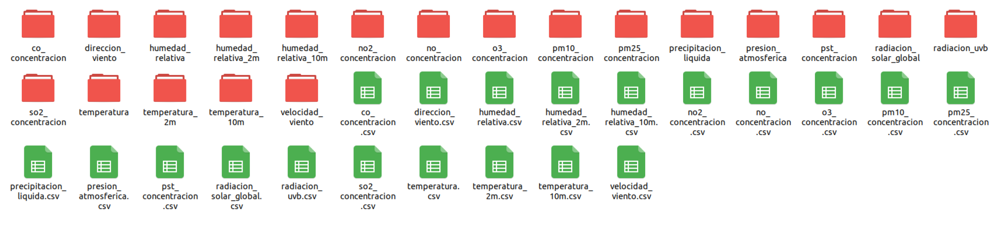

In [5]:
imshow_plots("img.png")

# Analizando dinámicas lineales en datos climáticos

El estudio de las dinámicas lineales a partir de un conjunto de datos climáticos implica un enfoque metodológico que busca identificar relaciones proporcionales y predecibles entre las variables. El primer paso es la recopilación y organización de los datos, asegurando que sean consistentes y de buena calidad. Esto puede incluir mediciones de temperatura, precipitación, presión atmosférica o concentraciones de gases de efecto invernadero, entre otros. A continuación, es esencial realizar una limpieza de los datos, eliminando valores atípicos o errores que puedan sesgar los resultados.

Una vez que los datos están listos, se procede a aplicar técnicas estadísticas que permitan identificar posibles relaciones lineales entre las variables. Uno de los métodos más utilizados es la regresión lineal, que busca ajustar una línea recta que explique cómo una variable dependiente (como la temperatura) cambia en función de otra variable independiente (como la concentración de dióxido de carbono). Esta relación lineal es útil para predecir tendencias futuras y entender cómo las variables se afectan mutuamente en condiciones controladas.

Después de la regresión lineal, se evalúa la significancia de los resultados. Esto se puede hacer calculando coeficientes de correlación, que miden la fuerza y dirección de la relación lineal entre dos variables. Además, se emplean pruebas estadísticas como el p-valor para determinar si las correlaciones observadas son estadísticamente significativas. Si los resultados indican una relación lineal fuerte y significativa, es posible modelar el comportamiento futuro del sistema climático bajo el supuesto de que estas relaciones se mantendrán constantes en el tiempo.

## Visualización de series temporales

Para iniciar el análisis, primero debemos cargar los datos correctamente en el entorno de trabajo. Esto implica importar los datos desde su ubicación actual, donde fueron almacenados en archivos `.CSV`, siguiendo el procedimiento detallado en las secciones anteriores. Esta etapa es crucial para garantizar que la información esté disponible en un formato adecuado para el análisis posterior. Para comenzar con el análisis, iniciaré con una visualización de las series temporales por varible. Las gráficas se crear con las 59 lineas de cogido mostradas a continuación.

In [ ]:
f24h = "Fecha_24h"
dens = "Concentración"
ui = np.array([[i, j] for i in range(1) for j in range(2)])

def df_umbr(dataframe):
    dataframe.set_index(f24h, inplace=True)
    dataframe["Periodo"] = dataframe.index.to_period("D").copy()
    df_ubr = dataframe.groupby("Periodo")[dens].describe()
    return df_ubr


for ur in range(0, len(list(variables_contaminacion.keys())), 2):
    fig = plt.figure(figsize=(20, 5), tight_layout=True)
    gs = gridspec.GridSpec(1, 2)
    for us in range(ur, ur + 2):
        uz = us % 2
        ot = list(variables_contaminacion.keys())[us]
        ax0 = fig.add_subplot(gs[ui[:, 0][uz], ui[:, 1][uz]])
        data_frame_subconjunto = pd.read_csv(
            "datos_segmentados/" + ot + ".csv", dtype=str
        )

        data_frame_subconjunto[dens] = data_frame_subconjunto[dens].astype(float)
        data_frame_subconjunto[f24h] = pd.to_datetime(
            data_frame_subconjunto[f24h], format="%Y/%m/%d %H:%M:%S"
        )
        dtframe = data_frame_subconjunto.copy()
        dev_std = dtframe[dens].std()
        media = dtframe[dens].mean()

        umb0, umb1 = umbral_iqr(dtframe, dens)

        df_umb0 = dtframe[(dtframe[dens] > umb1) | (dtframe[dens] < umb0)].copy()
        df_umbr(df_umb0)["mean"].plot(style="-o", markersize=3, color="red")

        df_umb1 = dtframe[(dtframe[dens] < umb1) & (dtframe[dens] > umb0)].copy()
        df_umbr(df_umb1)["mean"].plot(style="-o", markersize=3, color="blue")

        unidad_variable = variables_contaminacion[ot]["unidad"]
        nombre_variable = variables_contaminacion[ot]["variable"]
        ax0.xaxis.set_tick_params(labelsize=17)
        ax0.yaxis.set_tick_params(labelsize=17)
        ax0.set_xlabel(f"Tiempo(días)", fontsize=20)
        ax0.set_ylabel(f"{nombre_variable} ({unidad_variable})", fontsize=18)
        ax0.set_title(f"{nombre_variable} en función del tiempo", fontsize=20)

    fig.tight_layout()
    plt.subplots_adjust(wspace=0.15)
    ncont = int(ur / 2)
    fig.savefig(f"plots/img_std{ncont}.png")
    if ur==10:
        break
    # plt.show()

Las gráficas presentadas ilustran el comportamiento de las series temporales de cuatro variables ambientales, medidas desde enero de 2011 hasta diciembre de 2018: **concentración de NO (Óxidos de Nitrógeno)**, **humedad relativa**, **humedad relativa a 2 metros** y **humedad relativa a 10 metros**. La mayoría de las series temporales fueron registradas con una frecuencia de muestreo de 1 hora, mientras que otras fueron registradas con frecuencias de 24 horas. Cada punto en las gráficas representa el promedio diario de los datos recopilados para cada variable, un proceso realizado para mejorar la visualización de la variabilidad promedio diaria de la serie temporal y facilitar el análisis de las tendencias a lo largo del tiempo. Estas visualizaciones proporcionan una visión integral del comportamiento de estas variables ambientales en función del tiempo.

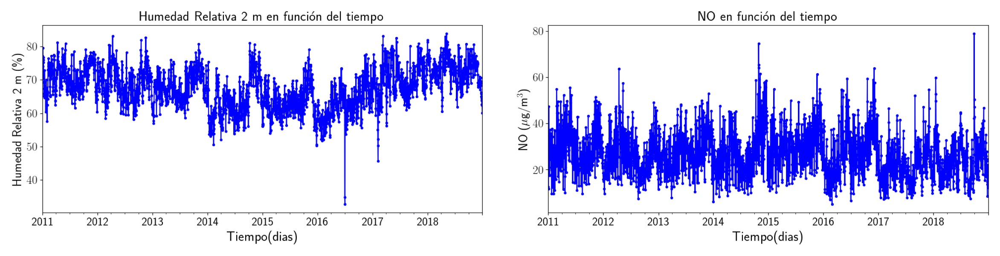

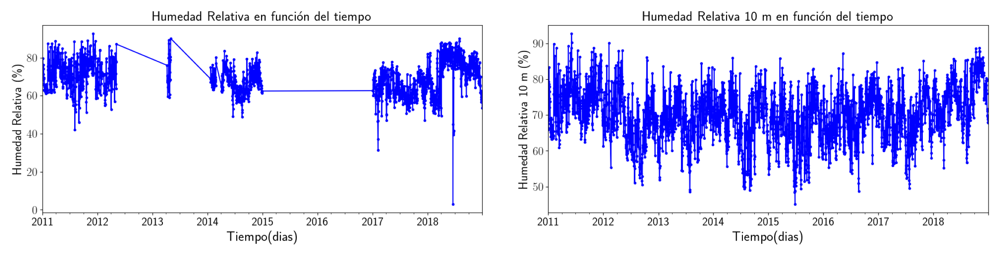

In [11]:
imshow_plots("plots/img2.png"); imshow_plots("plots/img1.png")

Analizar todos los datos de una variable sin segmentarlos por municipio puede llevar a conclusiones equivocadas. Las mediciones de diferentes localidades están influenciadas por condiciones locales específicas, como la altitud, la proximidad al mar, el uso del suelo y el clima, que afectan significativamente los datos y generan patrones y escalas diversas entre los municipios. Al no considerar estas diferencias, se corre el riesgo de mezclar información de contextos distintos, lo que puede distorsionar los resultados y dificultar una interpretación mas adecuada.

Aplicar un umbral único a los datos de las distintas variables sin considerar las  diversas escalas puede generar interpretaciones incorrectas. Un umbral establecido sin tener en cuenta las diferencias locales pueden eliminar datos valiosos que, aunque parezcan irrelevantes en una escala general, son esenciales en su contexto específico. Esto puede llevar a una sobreestimación en los análisis y a la pérdida de información clave sobre las variaciones locales.

Por ejemplo, eventos climáticos que son extremos en una región pueden no serlo en otra. Si se aplican los mismos criterios de umbral, se pueden omitir detalles importantes que reflejan las diferencias locales, limitando la comprensión global del fenómeno. A continuación mostramos un gráfico en donde se observa como se dividen los datos al aplicar un umbral intercuartílico ($Q^{\pm} \pm 1.5IQR$, donde $IQR = Q^{+} - Q^{-} $ y $Q^{-}$, $Q^{+}$, son los cuartiles del 25% y 75% respectivamente) puede ignorar drásticamente datos de la serie temporal. En la figura, los datos de color rojo están por fuera de los $IRQ$, observe que para el caso del NO la cantidad de datos considerados como outliers con este criterio es muy grande.


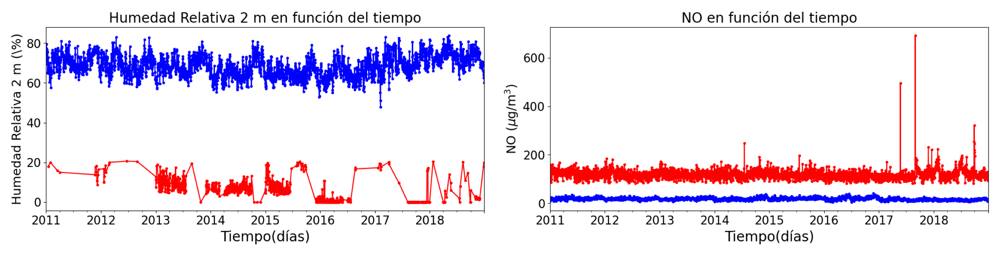

In [326]:
imshow_plots("plots/img_std2.png")

## Revisión de datos locales

La revisión local de datos es un proceso crucial que consiste en examinar los datos por municipio en lugar de considerar el conjunto global. Esta metodología permite una inspección más detallada y específica, teniendo en cuenta las particularidades y condiciones locales que pueden influir en las mediciones.

En esta sección, se incluyen tanto análisis estadísticos como gráficos para una comprensión integral. A través del análisis estadístico, podemos calcular medidas de tendencia central, dispersión y otros indicadores que revelan las características específicas de cada municipio. Los gráficos, por su parte, facilitan la visualización de patrones y tendencias a nivel local, permitiendo identificar variaciones y comportamientos que podrían ser invisibles en un análisis global.

In [ ]:
dtf_csv = pd.read_csv("datos_segmentados/temperatura_10m.csv", dtype=str)
dtf_csv["Concentración"] = dtf_csv["Concentración"].astype(float)
datfram = dtf_csv[["Código del municipio", "Nombre del municipio", "Concentración"]]
data_frame_groupby = datfram.groupby("Nombre del municipio")
unidad_variable = variables_contaminacion["temperatura_10m"]["unidad"]
nombre_variable = variables_contaminacion["temperatura_10m"]["variable"]
abreviatura_variable = variables_contaminacion["temperatura_10m"]["abreviatura"]
df_describe = data_frame_groupby.describe()
datf_cont=df_describe["Concentración"]
# err_std = datf_cont["std"] / np.sqrt(datf_cont["count"])
# datf_cont.insert(3, "Error", err_std)
# df_reset = df_describe.reset_index(drop=True)
# dfi.export(datf_cont, f"tabla_df_{nombre_variable.replace(' ','_')}.png")

Como ejemplo: la tabla del DataFrame presentada se generó utilizando el método `describe()` aplicado a un DataFrame previamente agrupado con el método `groupby()`, a partir de un subconjunto de datos que corresponden a la variable climática `temperatura_10m.csv`. En este proceso, el método `groupby()` se utilizó para clasificar los datos por municipio, segmentando el conjunto de datos en grupos distintos según la ubicación geográfica. Posteriormente, el método `describe()` fue aplicado a cada uno de estos grupos, calculando y mostrando una serie de estadísticas descriptivas para cada municipio. Estas estadísticas incluyen el conteo de datos (`count`), la media (`mean`), la desviación estándar (`std`), entre otras métricas, proporcionando un resumen detallado de la distribución de las temperaturas a 10 metros en cada municipio. Este enfoque permite una visión más granular de los datos, destacando las variaciones y tendencias específicas para cada localidad.

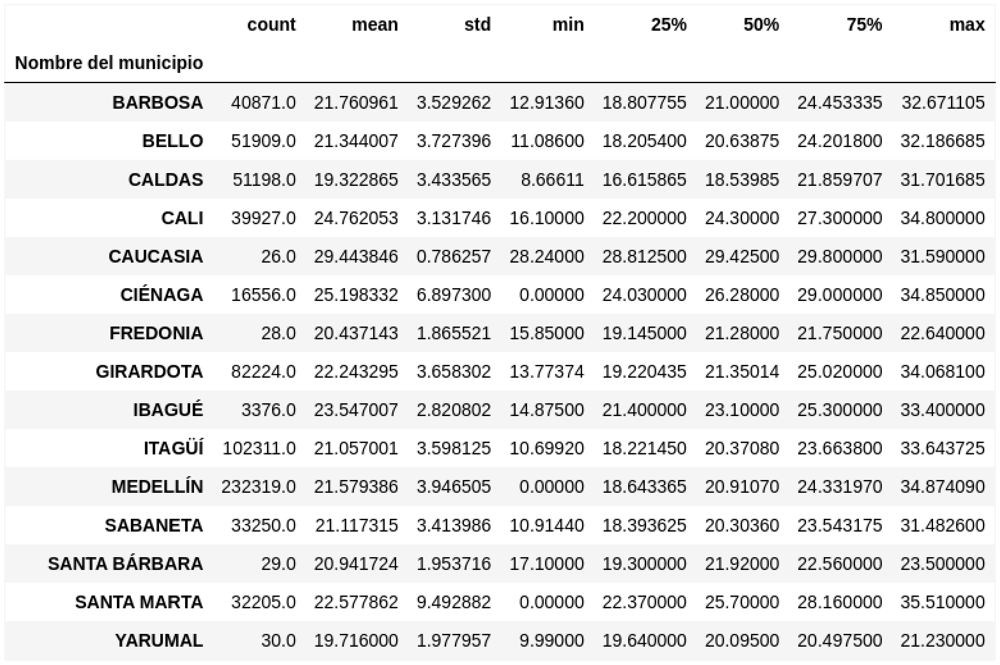

In [22]:
imshow_plots("tabla_df_Temperatura_a_10_m.png")

A continuación, mostramos el código cuyo objetivo es crear un gráfico que ilustra el comportamiento de los datos por región del dataframe anterior. Cabe aclarar que el código presentado es general y puede generar gráficos para todas las variables disponibles en el conjunto de datos. Sin embargo, a modo de ejemplo, en éste documento creamos solo un gráfico, ya que existen un total de 20 variables y mostrar gráficos para cada una de ellas no sería práctico. El propósito principal aquí es mostrarle al lector una visualización mas detallada de la variabilidad de los datos y destacar los problemas asociados con su recolección, ya que en muchos casos no es uniforme, lo que puede afectar la interpretación y análisis de los resultados al enfrentarnos con muestras de diferentes tamaños.

In [ ]:
fig = plt.figure(figsize=(27, 17))
grid = fig.add_gridspec(2, 2, width_ratios=[1, 2])
ax0 = fig.add_subplot(grid[:, 0])
ax1 = fig.add_subplot(grid[0, 1])
ax2 = fig.add_subplot(grid[1, 1])

datf_cont["count"].plot(kind="bar", linewidth=2,ax=ax1, width=1, ec="w", color="#008B8B", legend=False)
datf_cont["mean"].plot(
    yerr=datf_cont["std"],
    kind="bar",
    capsize=5,
    ecolor="red",
    linewidth=2,
    ax=ax2,
    width=1,
    ec="w",
    color="#00008B",
    legend=False,
)
df_group_dfi = datf_cont[["count", "mean"]]
dfi.export(df_group_dfi, "tabla_df.png")
img = np.asarray(Image.open("tabla_df.png"))
ax0.imshow(img)
ax0.axis("off")
ax0.set_title(
    f" Tabla descriptiva de {nombre_variable} ({abreviatura_variable})",
    fontsize=35,
)

ax1.xaxis.set_tick_params(labelsize=22)
ax1.yaxis.set_tick_params(labelsize=27)
ax1.set_xlabel(f"Municipio", fontsize=32)
ax1.set_ylabel(f"Conteo {abreviatura_variable} ({unidad_variable})", fontsize=32)
ax1.set_title(
    f"Conteo de {nombre_variable} ({abreviatura_variable}) por municipio",
    fontsize=35,
)

ax2.xaxis.set_tick_params(labelsize=22)
ax2.yaxis.set_tick_params(labelsize=27)
ax2.set_xlabel(f"Municipio", fontsize=32)
ax2.set_ylabel(
    rf"$\langle${abreviatura_variable}$\rangle$ ({unidad_variable})", fontsize=32
)
ax2.set_title(
    f"Promedio de {nombre_variable} ({abreviatura_variable}) por municipio", fontsize=35
)

ax1.set_yscale("log")
plt.setp(ax2.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(ax1.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
fig.tight_layout()
plt.subplots_adjust(wspace=0.15)
fig.savefig(f"plots/temperatura_10m.png", bbox_inches="tight")
plt.show()

La gráfica presentada muestra dos aspectos clave del conjunto de datos `temperatura_10m.csv` relacionados con la temperatura medida a 10 metros desde el punto de referencia: el conteo de los datos y la media calculada para cada grupo de datos climáticos correspondiente a cada municipio. El gráfico de barras verde azulado representa el conteo de datos obtenidos para cada municipio, mientras que el gráfico de barras azul muestra la media de las temperaturas registradas a 10 metros $\langle T_{10} \rangle$, desde el punto de referencia para cada uno de estos grupos de datos climáticos. 

El eje vertical del gráfico de conteo de datos se ha ajustado a una escala logarítmica para mejorar la visualización, ya que las barras muy altas en una escala lineal podrían ocultar las barras donde los datos son menos frecuentes. Este ajuste permite una representación más clara de las variaciones en el número de mediciones. 

Las barras de error en color rojo indican la desviación estándar de los datos, proporcionando una visualización de la dispersión alrededor de la media. Se observa que la dispersión en Santa Marta es muy significativa, sugiriendo una alta variabilidad en las temperaturas registradas, mientras que en Caucasia la dispersión es notablemente pequeña, indicando una menor variabilidad. 

Además, el conteo de datos en el DataFrame y en el gráfico revela una discrepancia significativa en el número de mediciones entre municipios. Esta discrepancia es un factor importante que debe ser considerado al interpretar los resultados y al concluir los análisis, ya que puede afectar la representatividad y precisión de las conclusiones sobre las condiciones climáticas en diferentes localidades.

Para obtener el DataFrame utilizado para crear estas gráficas, se aplicó el método `groupby()` para agrupar los datos por municipio, seguido del método `describe()` para calcular las estadísticas descriptivas. Posteriormente, el método `df.plot()` se empleó para visualizar tanto el conteo de los datos como la media, junto con las barras de error, facilitando una comprensión detallada de las variaciones y tendencias en las temperaturas a 10 metros desde el punto de referencia a nivel municipal.

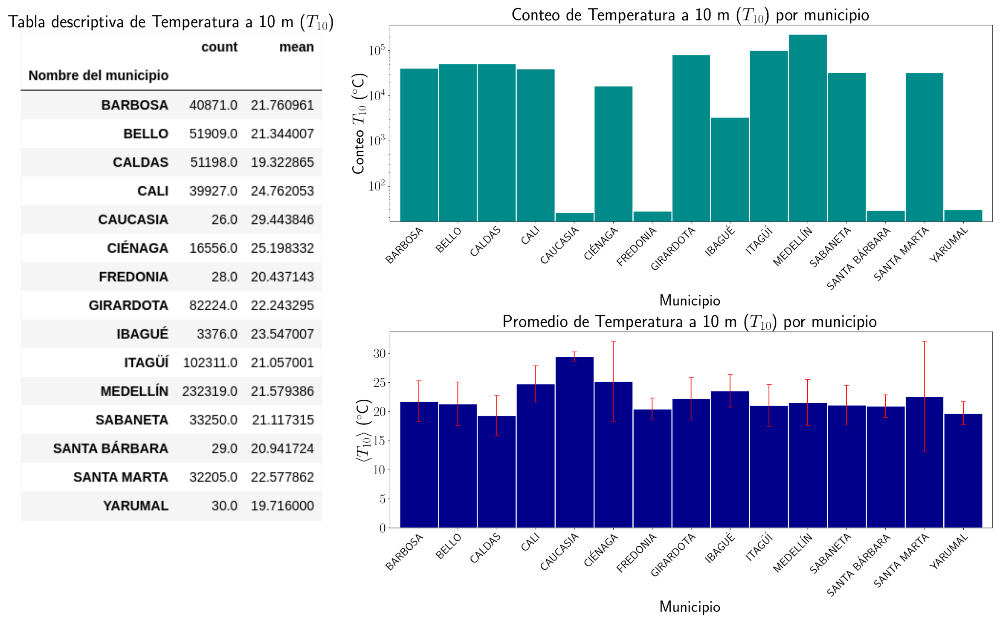

In [19]:
imshow_plots("plots/temperatura_10m.png")

## Revisión de datos locales y aplicación del criterio IQR en series temporales climáticas

Esta sección, vamos a emplear un enfoque  basado en el rango intercuartílico (IQR) para identificar y eliminar los datos que se consideran outliers excesivamente inusuales. Este criterio es especialmente útil en el análisis climático, donde los valores extremos pueden corresponder a eventos atípicos o errores de medición, los cuales, si no se manejan adecuadamente, pueden distorsionar los resultados generales.

El IQR, que mide la dispersión de los datos centrales, se calcula como la diferencia entre el tercer cuartil ($Q^+$) y el primer cuartil ($Q^-$). Para identificar los outliers, aplicaremos el rango de $Q^{\pm} \pm 1.5IQR$, donde $IQR = Q^{+} - Q^{-} $. Los valores que caigan fuera de este rango serán considerados outliers y eliminados, ya que están demasiado alejados de las condiciones normales y podrían afectar negativamente la interpretación de los patrones generales.

Este método tiene la ventaja de ser robusto ante la presencia de distribuciones no normales, lo que lo convierte en una herramienta más confiable que el uso de desviaciones estándar en conjuntos de datos con alta variabilidad. Al eliminar estos outliers, nos aseguramos de que el análisis climático mantenga su integridad, capturando las tendencias principales sin verse distorsionado por eventos raros que no reflejan el comportamiento típico del sistema climático.

Inicialmente vamos a definir algunas variables de interés que serán necesarias para el siguiente análisis.

In [21]:
fecha24h = "Fecha_24h"  # datos fecha de eventos
pathdir = "datos_segmentados"  # directorio datos agrupados
formatofecha = "%Y/%m/%d %H:%M:%S"  # formato para la fecha.
fechahoras = "Fecha_horas"
densidad = "Concentración"  # datos variable admosférica
municipio = "Nombre del municipio"  # datos fecha en formato 24 horas
periodo = "H"  # agrupe los datos por periodo: hora (H), dia(D), semana(W), mensual(M), anual (H)
varperiodo = "Periodo"  # creando columna de datos agrupados por periodo
varestadist = ("mean")  # estadística de interés, media(mean) desviación estándar (std), etc.
id_municipio = "Código del municipio"  # Código del municipio
unid = "unidad"       #unidades de cada variable
abrev = "abreviatura"    # símbolo de abreviatura de variable
variable= "variable"     #variable en estudio
color = np.random.rand(200, 3)
mcolr = np.mean(color, axis=1)
colores = color[np.where(mcolr < 0.5)]
adres_dir = os.listdir(pathdir)
pathfil = list(variables_contaminacion.keys())  

En el siguiente fragmento de código, se generan histogramas de frecuencia para cada una de las variables climáticas de los municipios en estudio. Estas variables incluyen factores como la dirección del viento, la temperatura, la humedad relativa, y la precipitación, entre otras. Los histogramas permiten visualizar la distribución de los datos, mostrando cuántas veces ocurren ciertos valores dentro de un rango específico.

El código no solo genera estos histogramas, sino que también calcula las correlaciones de Pearson entre los diferentes histogramas de frecuencia de las variables climáticas. Este análisis de correlación permite identificar qué tan relacionadas están las distribuciones de dos variables. Un valor de correlación cercano a 1 indica una relación positiva fuerte, mientras que un valor cercano a -1 indica una relación negativa fuerte. Un valor cercano a 0 sugiere que no hay relación significativa entre las variables.

El propósito de este análisis es evaluar cómo se comportan las distintas variables climáticas en cada municipio y cómo se relacionan entre sí en cada región, lo que podría ser útil para identificar patrones climáticos o detectar comportamientos anómalos en diferentes zonas.

La función `function_df_clima` está diseñada con el objetivo de identificar y retirar los valores atípicos (outliers) de los diferentes conjuntos de datos climáticos de cada municipio.

In [27]:
def function_df_clima(var_clima):
    print(var_clima)
    adres_dir = os.listdir(f"{pathdir}/{var_clima}")
    nbins_apped = []; df_csv = []; dats_min = []; df_densidad = []; municipios = []
    for datsmun in adres_dir:
        dfcsv = pd.read_csv(f"{pathdir}/{var_clima}/{datsmun}", dtype=str)
        dats_min.append(len(dfcsv[densidad]))
        df_csv.append(dfcsv)
    ndats = pow(10, np.floor(np.log10(np.mean(dats_min))))
    for dfcsv in df_csv:
        if len(dfcsv[densidad]) >= ndats:
            dfcsv[fecha24h] = pd.to_datetime(dfcsv[fecha24h], format=formatofecha)
            dfcsv = dfcsv.set_index(fecha24h).copy()
            dfcsv[densidad] = dfcsv[densidad].astype(float)
            umbQ1, umbQ3 = umbral_iqr(dfcsv, densidad)
            df_loc1 = dfcsv[(dfcsv[densidad] < umbQ3) & (dfcsv[densidad] > umbQ1)]
            if len(df_loc1[densidad])!=0:
                municipios.append(df_loc1[municipio].unique().tolist()[0])
                df_densidad.append(df_loc1)
                k = len(np.histogram_bin_edges(df_loc1[densidad], bins="auto"))
                nbins_apped.append(k)
            else:
                print("Dataframe vacío", len(df_loc1[densidad]))
    if len(nbins_apped)!=0:
        nbins = int(np.mean(nbins_apped))
        return df_densidad, nbins, municipios
    else:
        return [],[],[]

In [ ]:
mx_df=[];list_bn=[];lista_municipal=[]
for var_clima in (pathfil):
    lista_df, list_nbins,municipio_dep=function_df_clima(var_clima)
    lista_municipal.append(municipio_dep)
    mx_df.append(lista_df)
    list_bn.append(list_nbins)

In [ ]:
for i in range(0,20,2):
    var = pathfil[i : i + 2]
    vr = variables_contaminacion
    ejx0 = f"Tiempo (h)"#{vr[var[0]][abrev]}({vr[var[0]][unid]})"
    ejx1 = f"Tiempo (h)"  # {vr[var[1]][abrev]}({vr[var[1]][unid]})"
    ejy0 = rf"Densidad {vr[var[0]][abrev]}({vr[var[0]][unid]})"
    ejy1 = rf"Densidad {vr[var[1]][abrev]}({vr[var[1]][unid]})"
    tit0 = rf"Densidad de {vr[var[0]][abrev]} vs. Tiempo"
    tit1 = f"Densidad de {vr[var[1]][abrev]} vs. Tiempo"
    figura = figure_plots(
        i,
        mx_df[i : i + 2],
        list_bn[i : i + 2],
        densidad,
        eje_x=[ejx0, ejx1],
        eje_y=[ejy0, ejy1],
        titulo=[tit0, tit1],
        labelsize=50,
        fontsize=50,
        figsize=(30, 12),
        wspace=0.25,
    )

### Representación gráfica de los conjuntos de datos en función del tiempo

Las gráficas presentadas muestran algunos de los conjuntos de datos correspondientes a diversas variables climáticas, donde se han excluido cuidadosamente los datos atípicos. Esta exclusión asegura una representación más precisa de las condiciones climáticas típicas en las diferentes localidades analizadas. Cada color en las gráficas corresponde a los datos de un municipio distinto, lo que facilita la comparación entre las variaciones climáticas de cada región. Todas las variables de estudio se grafican en función del tiempo, lo que permite observar cómo evolucionan en cada localidad a lo largo del periodo analizado. Al observar el comportamiento disperso en los datos, se puede apreciar que, a pesar de ciertas similitudes generales, cada municipio presenta patrones climáticos únicos, reflejando la diversidad geográfica y meteorológica de las áreas estudiadas.

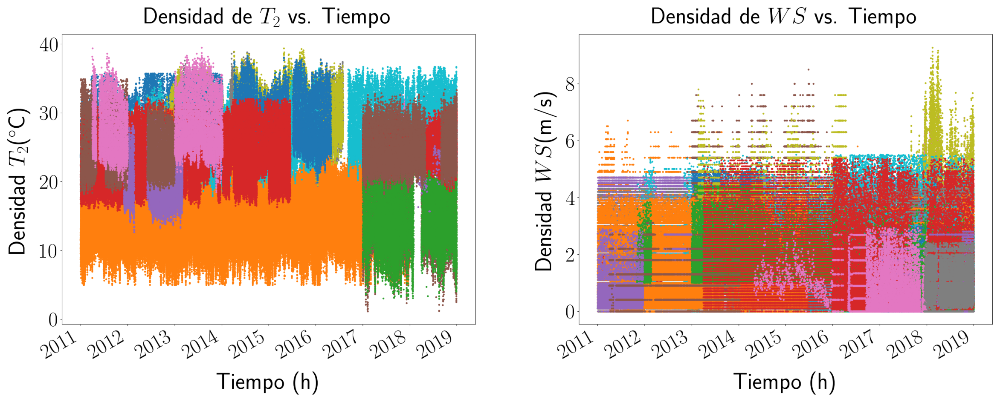

In [5]:
imshow_plots("plots/dispers18.png"); 

Los gráficos en función del tiempo muestran datos en diferentes escalas, lo que refleja el comportamiento variado de las variables climáticas en las distintas regiones geográficas. Este fenómeno se debe a las diferencias geográficas y a las condiciones ambientales específicas de cada zona. Por ejemplo, el gráfico de temperatura ilustra claramente cómo los datos varían en escalas diferentes, ya que las temperaturas registradas en las distintas regiones de Colombia son muy diversas. Mientras que algunas zonas, como las regiones costeras, presentan temperaturas más altas de manera consistente, otras áreas, como las regiones montañosas, muestran temperaturas significativamente más bajas. Esta variación en las escalas es un reflejo directo de la complejidad y diversidad climática del país, donde factores como la altitud, la proximidad al mar y las corrientes atmosféricas influyen de manera notable en los patrones climáticos observados.

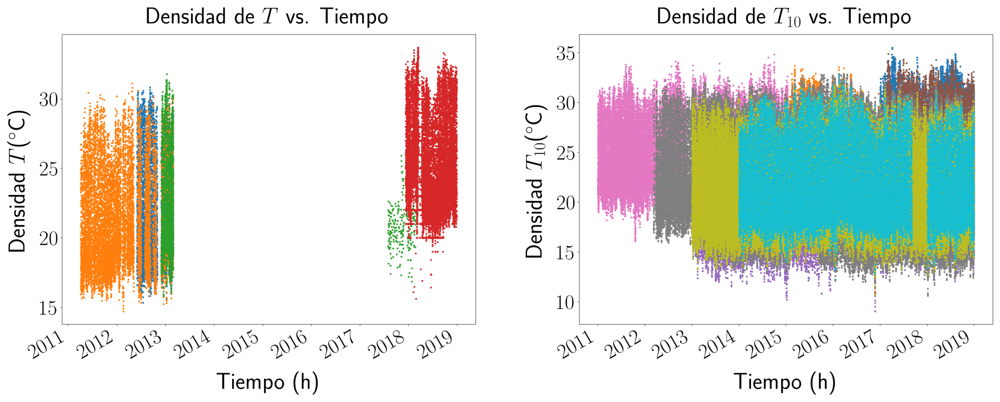

In [6]:
imshow_plots("plots/dispers16.png")

Los gráficos de humedad relativa y concentración de NO (óxido nítrico) también muestran variaciones en la escala de los datos debido a las diferencias geográficas y ambientales de las distintas regiones. La **humedad relativa** es la cantidad de vapor de agua en el aire en relación con la cantidad máxima que el aire puede retener a una determinada temperatura. En zonas cercanas a cuerpos de agua o áreas con alta vegetación, como selvas o costas, la humedad relativa suele ser mayor, mientras que en regiones áridas o montañosas, la humedad tiende a ser más baja. Estas diferencias en los niveles de humedad se reflejan claramente en los gráficos, mostrando variaciones a lo largo del tiempo dependiendo de las condiciones locales.

Por otro lado, la concentración de **NO (óxido nítrico)** en el aire varía según factores como la actividad industrial, el tráfico vehicular y la combustión de combustibles fósiles, que tienden a ser más intensos en áreas urbanas. En las zonas rurales o con menos actividad industrial, los niveles de NO suelen ser más bajos. Esto se refleja en los gráficos de NO, donde las regiones urbanas presentan concentraciones más altas en comparación con las rurales.

Ambas variables, la humedad relativa y la concentración de NO, están influenciadas por la geografía y las condiciones ambientales locales. Los gráficos muestran cómo las regiones con climas húmedos o cercanas a áreas industriales tienden a tener escalas diferentes a las de zonas más secas o con menor actividad humana. Estas variaciones en las condiciones climáticas y de contaminación explican las diferencias observadas en los datos de las diferentes regiones a lo largo del tiempo.

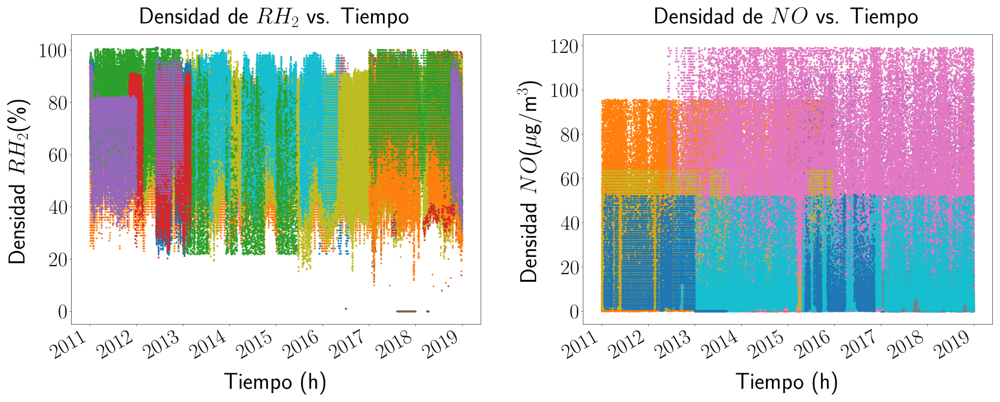

In [7]:
imshow_plots("plots/dispers4.png")

Los gráficos de presión atmosférica muestran variaciones en la escala de los datos debido a diferencias geográficas y ambientales. La presión atmosférica es mayor en regiones bajas, como las zonas costeras, y menor en áreas montañosas, debido a que la cantidad de aire sobre una región es mayor a nivel del mar y menor a altitudes elevadas. Además, factores meteorológicos como los sistemas de alta y baja presión también influyen en estas fluctuaciones.

El aire puede ser más denso por dos razones principales: la temperatura y la altitud. El aire frío es más denso porque las moléculas se mueven más lentamente y están más compactas, mientras que el aire caliente es menos denso. A nivel del mar, la mayor cantidad de aire apilado sobre la superficie genera mayor presión. En un **sistema de alta presión**, el aire frío y denso desciende, lo que provoca condiciones estables y cielos despejados. En contraste, un **sistema de baja presión** se forma cuando el aire más cálido y menos denso asciende, generando nubes y lluvias.

Estas diferencias en la densidad del aire y en los sistemas de presión atmosférica se reflejan en los gráficos. Las regiones de baja altitud y con aire más frío tienden a mostrar presiones más altas, mientras que las áreas montañosas o más cálidas presentan presiones más bajas. Estas variaciones en los patrones atmosféricos explican la diversidad de los datos observados en función del tiempo en las distintas regiones.

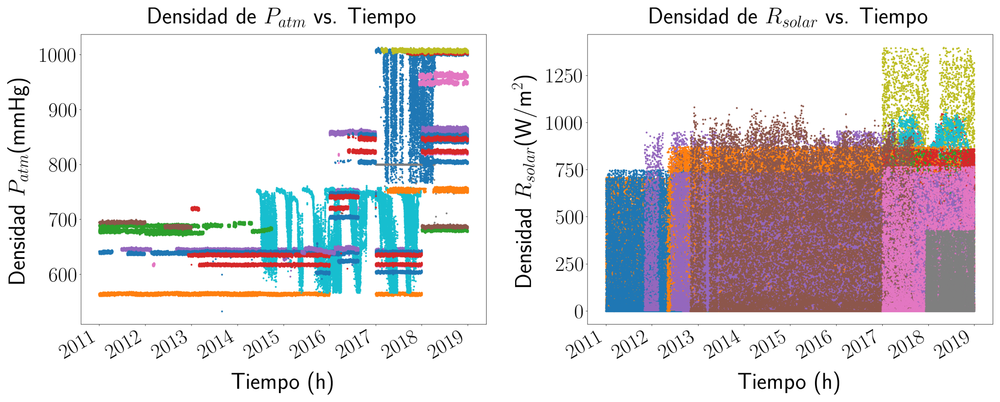

In [8]:
imshow_plots("plots/dispers12.png")

### Histogramas comparativos por municipios de las variables climáticas 

Los gráficos que se muestran a continuación corresponden a los histogramas de las variables climáticas, clasificados por municipio. Cada histograma ofrece una representación de la distribución de los valores climáticos observados en cada localidad, proporcionando una visión clara de la frecuencia con la que ocurren ciertos rangos de valores. Estos gráficos permiten identificar patrones específicos dentro de cada municipio, destacando la variabilidad y el comportamiento típico de cada variable climática. Al comparar los histogramas entre municipios, se pueden observar diferencias en la dispersión y concentración de los datos, lo que evidencia la diversidad climática entre las distintas regiones.

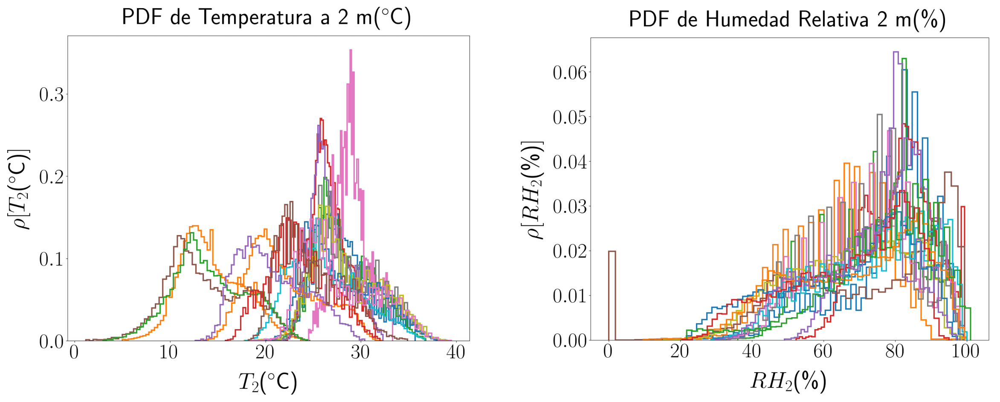

In [9]:
imshow_plots("plots/Graf19.png"); 

Los histogramas de la temperatura son notablemente más diversos en comparación con los histogramas de PM (partículas en suspensión), lo cual se debe a la mayor variabilidad de la temperatura en función de factores geográficos y estacionales. La temperatura varía significativamente entre regiones montañosas, costeras, urbanas y rurales, así como entre estaciones del año, lo que genera una amplia gama de distribuciones en los datos. Esto se refleja en los histogramas, donde se pueden observar desde temperaturas cálidas y estables en zonas costeras hasta fluctuaciones extremas en áreas montañosas o durante cambios estacionales.

Por otro lado, los histogramas de **PM (partículas en suspensión)** tienden a ser menos diversos porque la concentración de partículas depende más de fuentes puntuales, como la actividad industrial, el tráfico vehicular y las quemas agrícolas, que pueden ser constantes en ciertas áreas urbanas o rurales. Aunque las condiciones climáticas como el viento y la lluvia pueden influir en los niveles de PM, su variabilidad es más limitada en comparación con la temperatura, que está directamente relacionada con fenómenos geográficos y climáticos de mayor magnitud. Por ello, los histogramas de PM muestran distribuciones más homogéneas, especialmente en áreas donde las fuentes de contaminación son similares a lo largo del tiempo.

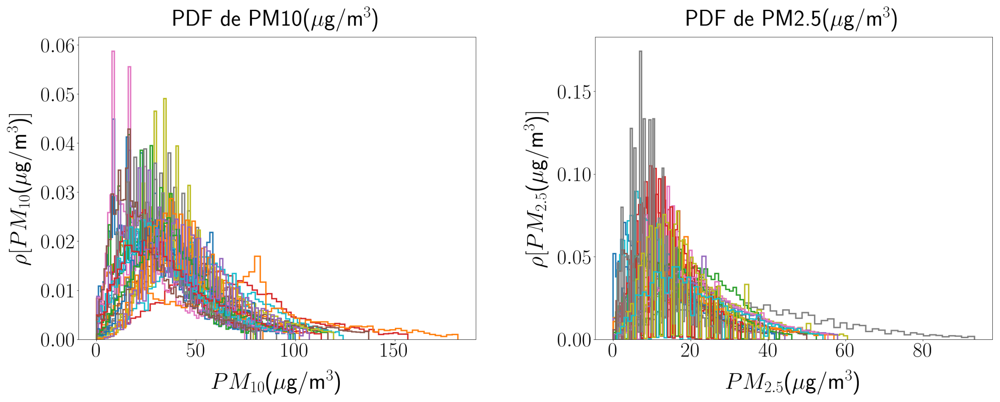

In [10]:
imshow_plots("plots/Graf8.png")

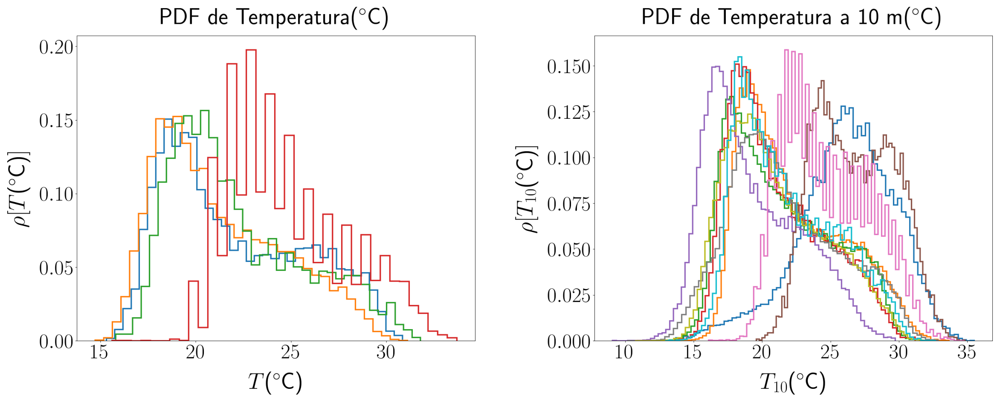

In [11]:
imshow_plots("plots/Graf16.png")

El siguiente código calcula las correlaciones entre la misma variable climática, como la temperatura, en diferentes municipios, con el objetivo de visualizar si los cambios en una variable en un lugar pueden estar relacionados con los de otro municipio. Los resultados se muestran utilizando gráficos con la función `imshow`, donde cada color indica el nivel de correlación entre las variables climáticas de los distintos municipios. Los colores más claros representan una mayor correlación, mientras que los tonos más oscuros indican una correlación más baja. Este análisis permite identificar si, por ejemplo, las variaciones de temperatura en un municipio están relacionadas con las de otro, lo que puede ser útil para estudiar patrones regionales o influencias climáticas compartidas entre localidades.

In [25]:
def func_array(lista_df,n_bins):
    array_freq = []
    if len(lista_df) != 0:
        for df in lista_df:
            fr, nb = np.histogram(df[densidad], bins=n_bins)
            fr = fr / sum(fr)
            array_freq.append(fr)
    else:
        print("Dataframe vacío",len(lista_df[densidad]))
    return array_freq

In [24]:
for u,list_dataf in enumerate(mx_df):
    array_freq = func_array(list_dataf,list_bn[u])
    corr_pears, valores_p = corr_pearsonr(np.array(array_freq))
    titulos = [
        f"Correlaciones de Pearson entre "
        rf"$\rho(${abreviatura_variable}$)$"
        f"\n de {abreviatura_variable} por municipio",
        "Valores p asociados para cada alternativa",
    ]

    dscrip = [
        rf"Correlaciones de Pearson de $\rho(${abreviatura_variable}$)$",
        "Valores p",
    ]

    farmers = [lista_municipal, lista_municipal]
    harvest = [corr_pears, valores_p]
    plt_corr_pears(
        harvest,
        titulos,
        farmers,
        figsize=(45, 35),
        labelsize=35,
        fontsize=55,
        tight_layout=True,
        padd=35,
        formato=r"${:.2f}$",
        descript=dscrip,
        nNums=10,
        size="5%",
        padr="2%",
        descrip_bar=50,
        var_clima=var_clima,
        wspace=0.5,
    )

### Patrones regionales o influencias climáticas compartidas entre localidades

Los mapas de calor generados con `imshow()` muestran los diferentes niveles de correlación entre una variable climática específica en distintos municipios. En estos gráficos, cada celda representa la correlación entre las mediciones de la misma variable climática, como la temperatura, en dos municipios diferentes. Los colores en el mapa indican el grado de correlación: los tonos más claros reflejan una alta correlación, mientras que los tonos más oscuros indican una baja correlación.

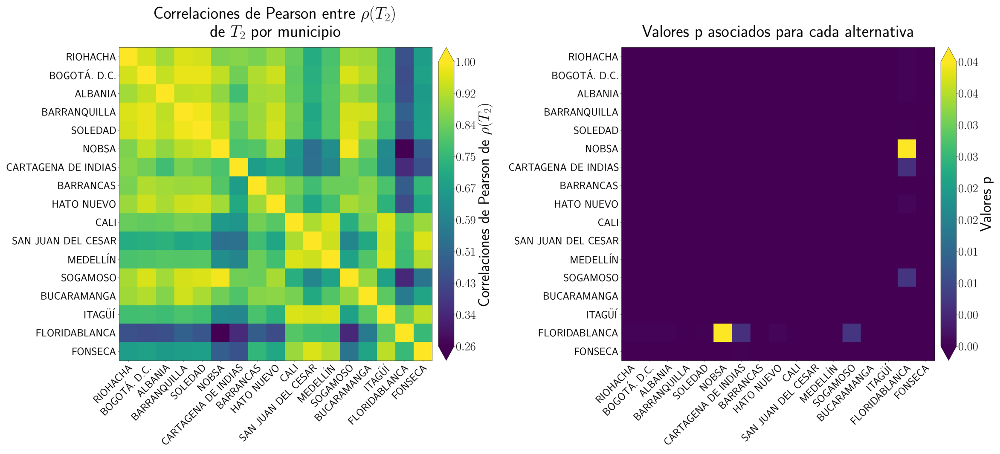

In [19]:
imshow_plots("plots/temperatura_2m_corr.png");

Estos mapas permiten visualizar cómo, a lo largo del tiempo, las variables climáticas en diferentes municipios pueden estar relacionadas entre sí. Por ejemplo, si los mapas muestran una alta correlación entre la temperatura en dos municipios, esto puede sugerir que los patrones de temperatura en esos lugares son similares o que están influenciados por factores climáticos compartidos, como corrientes atmosféricas o condiciones estacionales similares. La correlación entre variables climáticas puede variar dependiendo de la proximidad geográfica, las condiciones meteorológicas regionales y las características locales.

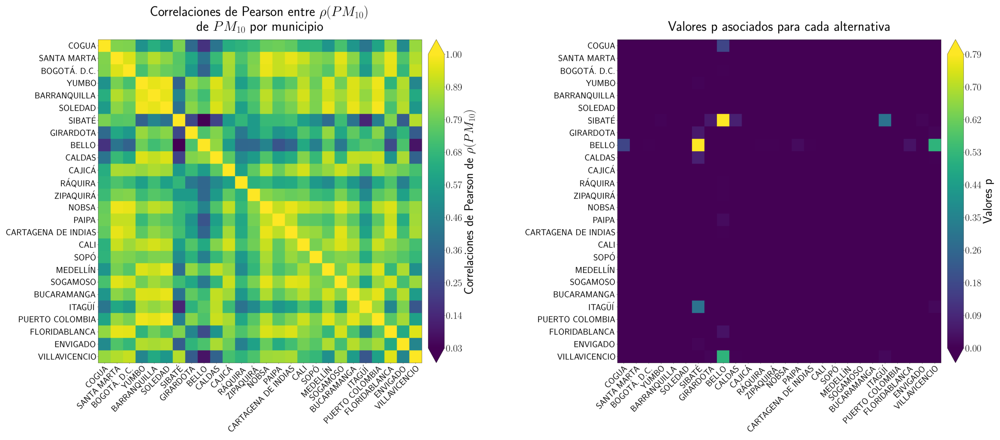

In [20]:
imshow_plots("plots/pm10_concentracion_corr.png")

Un **mapa de calor** es una representación gráfica de datos en una matriz, donde los valores numéricos se visualizan mediante una escala de colores. Este tipo de gráfico es útil para identificar patrones y relaciones en grandes conjuntos de datos, ya que permite observar de manera rápida y clara las áreas con alta o baja correlación entre variables. La visualización en colores facilita la comprensión de cómo las variables climáticas en diferentes municipios están interrelacionadas a lo largo del tiempo.

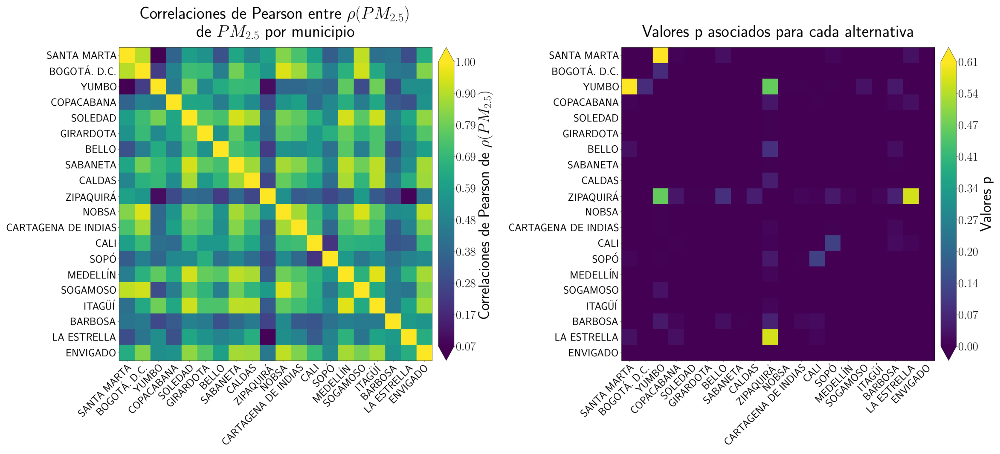

In [21]:
imshow_plots("plots/pm25_concentracion_corr.png")

Además de los mapas de calor que muestran los niveles de correlación entre las variables climáticas en distintos municipios, también es común generar una **matriz de p-valores** para complementar el análisis. Los p-valores indican la significancia estadística de las correlaciones calculadas. Un p-valor bajo (generalmente menor a 0.05) sugiere que la correlación observada es significativa y no se debe al azar, mientras que un p-valor alto indica que la correlación no es estadísticamente significativa. 

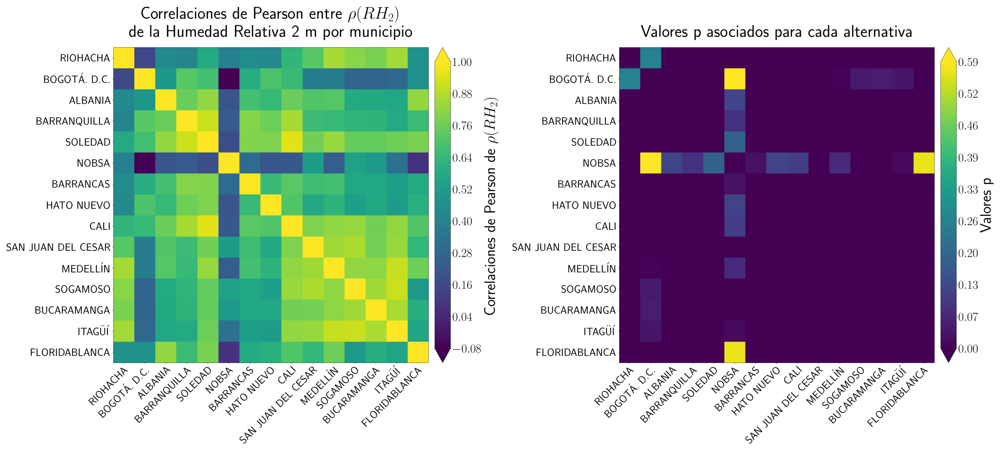

In [24]:
imshow_plots("plots/humedad_relativa_2m_corr.png")

La **matriz de p-valores** se presenta de manera similar a un mapa de calor, donde cada celda corresponde a un p-valor asociado con la correlación entre una variable climática en dos municipios. Esta matriz es fundamental para asegurar que las correlaciones que se observan en los mapas de calor son estadísticamente relevantes, lo que brinda mayor confianza en los patrones detectados. En resumen, mientras el mapa de calor muestra el nivel de correlación, la matriz de p-valores ayuda a determinar la fiabilidad de esas correlaciones.

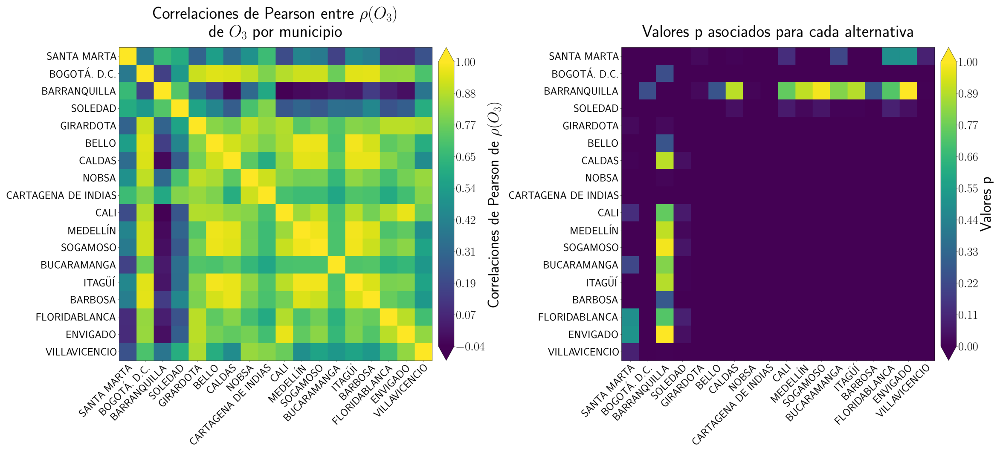

In [26]:
imshow_plots("plots/o3_concentracion_corr.png")

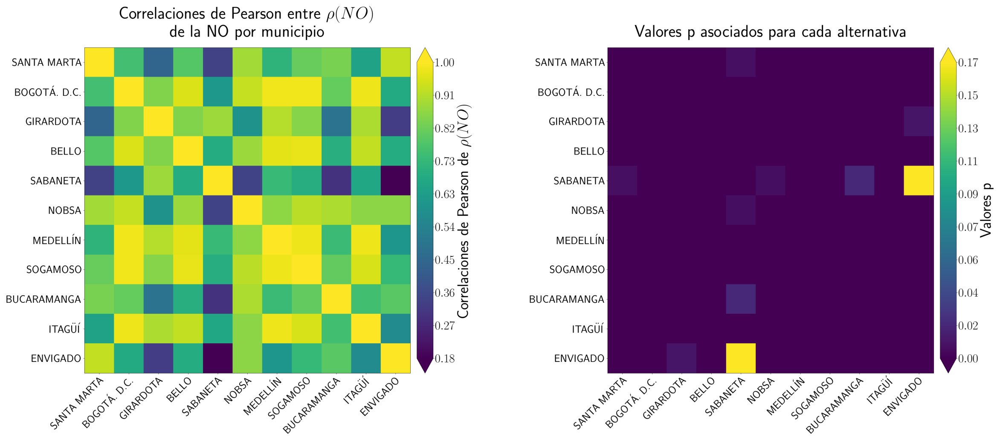

In [28]:
imshow_plots("plots/no_concentracion_corr.png")

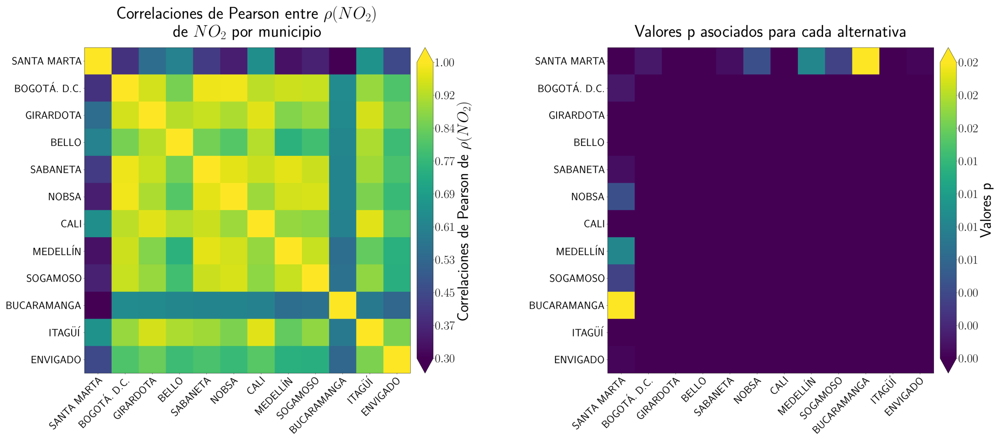

In [29]:
imshow_plots("plots/no2_concentracion_corr.png")

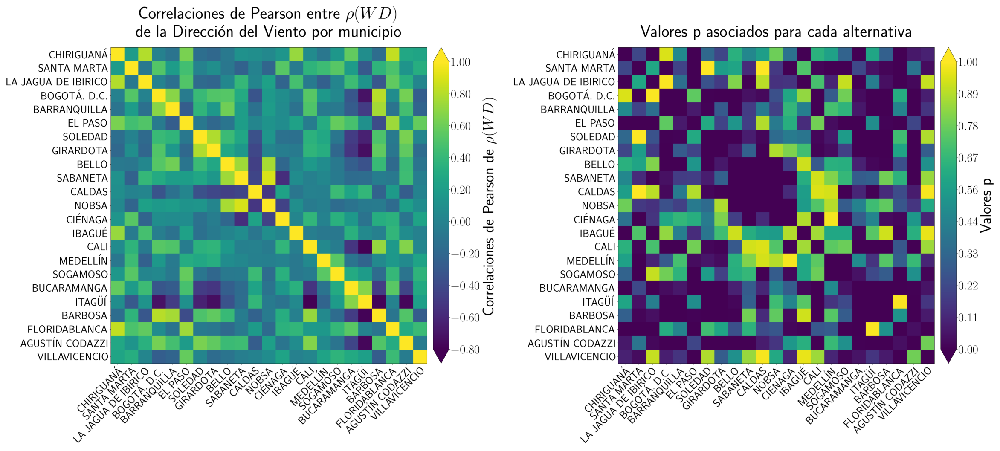

In [30]:
imshow_plots("plots/direccion_viento_corr.png")

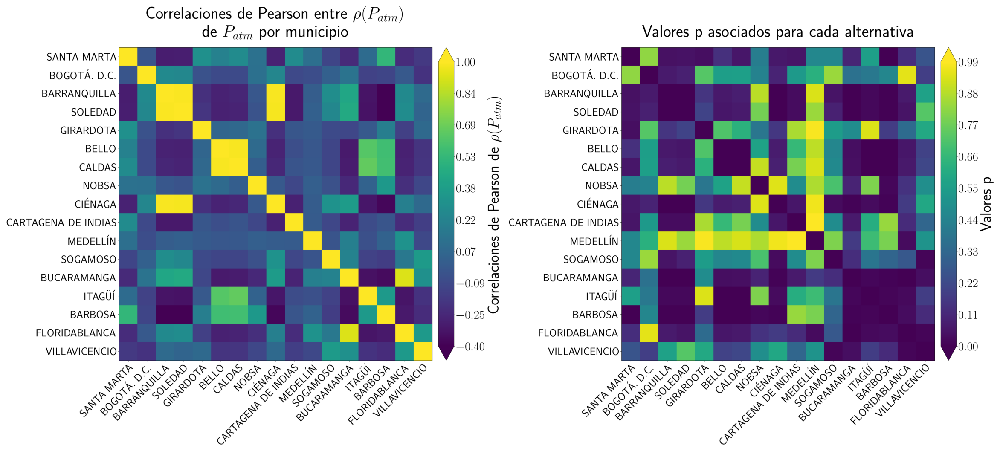

In [31]:
imshow_plots("plots/presion_atmosferica_corr.png")

Como trabajo adicional, se grafican las variables climáticas cuyos coeficientes de correlación de Pearson son mayores a 0.7. Este umbral indica una correlación fuerte entre las variables en diferentes municipios, lo que sugiere que los patrones de variación en una localidad están estrechamente relacionados con los de otra. Estas variables se visualizan en un gráfico de dispersión utilizando la función `plot()`, donde el eje X representa la **PDF (función de densidad de probabilidad)** de la variable climática en un municipio y el eje Y muestra la **PDF** correspondiente de otro municipio.

El propósito de este análisis es observar si los datos de ambos municipios se ajustan a un **modelo lineal común**. Si los puntos en el gráfico se distribuyen cerca de una línea recta, esto indicaría una relación lineal entre las PDF de las dos localidades, lo que sugiere que los datos siguen un patrón común a pesar de las diferencias geográficas o ambientales. Este enfoque permite identificar tendencias compartidas y construir modelos predictivos que relacionen las condiciones climáticas de distintas regiones mediante un ajuste lineal.

In [ ]:
list_arr = []; name_var = []; 
titX = []; titY = []; uni_var=[]

for u in [10,12]:
    print(pathfil[u])
    unidad_variable = variables_contaminacion[pathfil[u]]["unidad"]
    nombre_variable = variables_contaminacion[pathfil[u]]["variable"]
    abreviatura_variable = variables_contaminacion[pathfil[u]]["abreviatura"]
    uni_var.append(pathfil[u])
    name_var.append(f"Relación de {abreviatura_variable} entre los municipios $i, j$")
    titX.append(rf"$\rho[${abreviatura_variable}({unidad_variable})$]$ del Municipio $j$")
    titY.append(rf"$\rho[${abreviatura_variable}({unidad_variable})$]$ del Municipio $i$")
    list_arr.append(func_array(mx_df[u], list_bn[u]))
plots_lineal_model(0.12 ,list_arr, name_var, titX, titY,[0.12,0.1],[0.12,0.1],u)

Los resultados son prometedores, ya que los gráficos muestran que un modelo lineal puede ajustarse a la relación entre la misma variable climática en diferentes municipios. En estos gráficos, donde el eje X representa la **PDF** de la variable climática en un municipio y el eje Y la **PDF** de la misma variable en otro municipio, se observa una tendencia lineal en muchos casos. Esto sugiere que, bajo ciertas condiciones, existe una relación lineal significativa entre las variables climáticas de los municipios comparados, lo que indica que los cambios en un municipio están estrechamente correlacionados con los cambios en otro.

El análisis revela que las variables climáticas entre ellos sí pueden seguir una tendencia lineal. Este ajuste es posible considerando los niveles de error y dispersión presentes en los datos. Este hallazgo sugiere que, a pesar de las diferencias geográficas y climáticas, es posible predecir el comportamiento de una variable climática en un municipio a partir de los datos de otro, utilizando un modelo lineal adecuado.

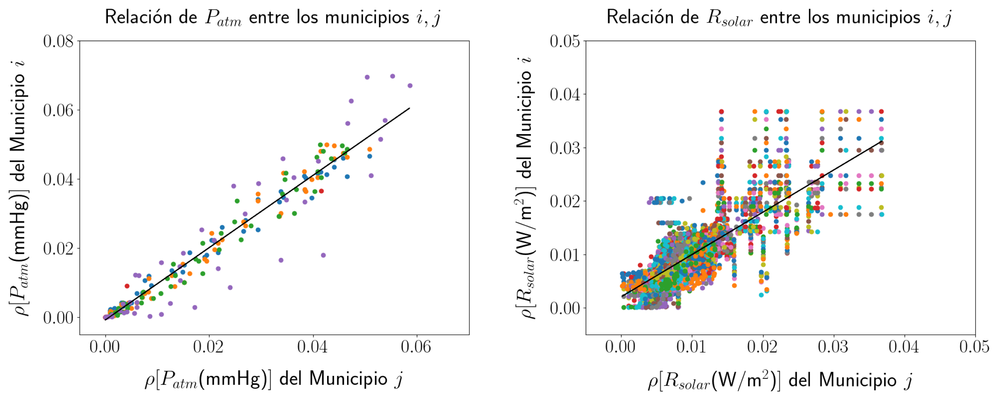

In [12]:
imshow_plots("plots/gxGraf13.png")

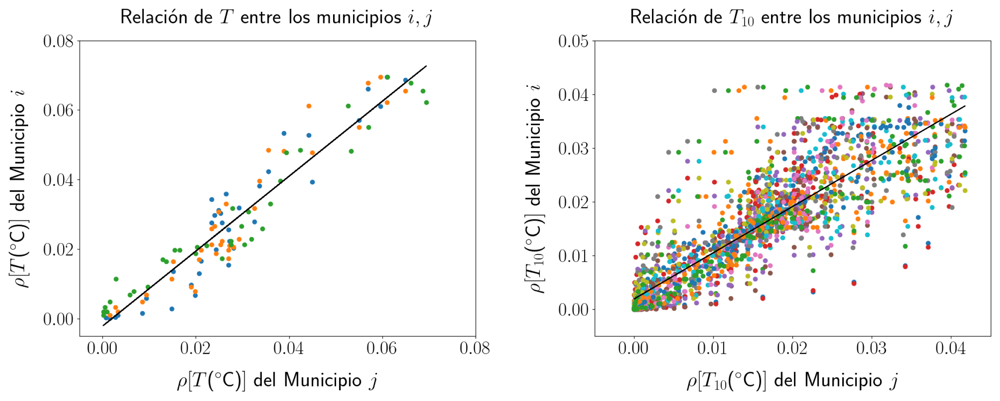

In [13]:
imshow_plots("plots/gxGraf17.png")

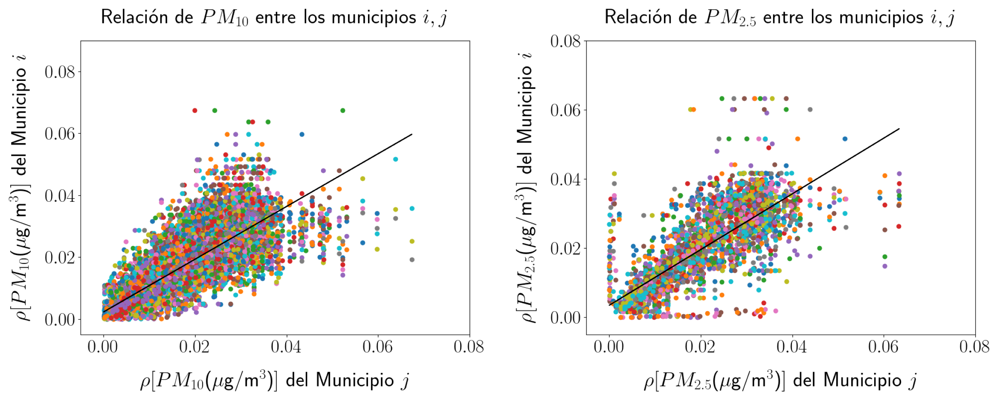

In [14]:
imshow_plots("plots/gxGraf9.png")

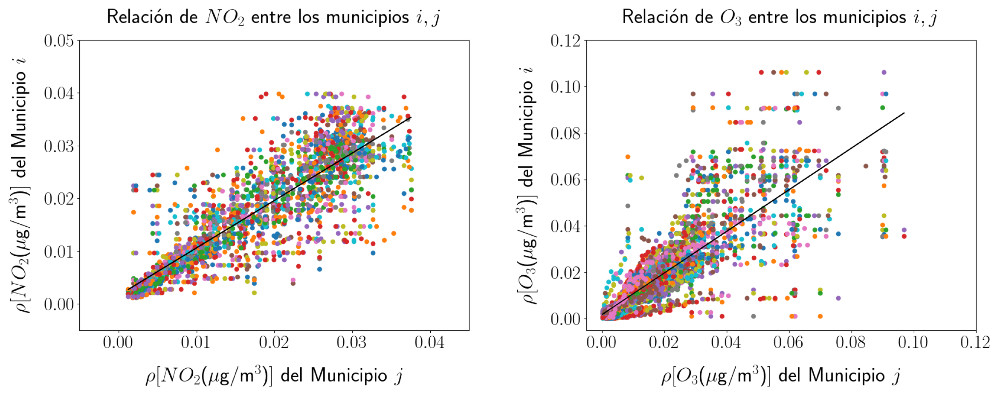

In [15]:
imshow_plots("plots/gxGraf7.png")

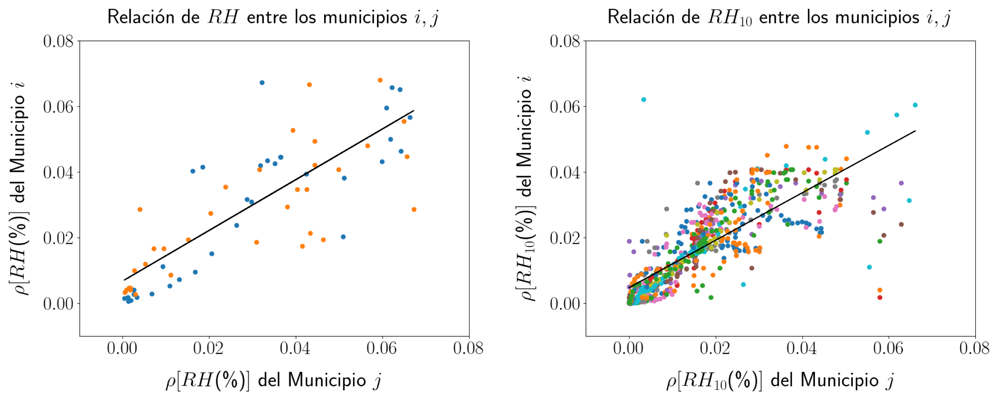

In [16]:
imshow_plots("plots/gxGraf3.png")

Para calcular las correlaciones entre las variables climáticas de los diferentes municipios, se utilizó el **coeficiente de correlación de Pearson**. Esta medida evalúa la relación lineal entre dos variables y se define matemáticamente como:

$$
r = \frac{\sum{(x_i - \bar{x})(y_i - \bar{y})}}{\sqrt{\sum{(x_i - \bar{x})^2} \sum{(y_i - \bar{y})^2}}} 
$$

donde $x_i$ y $y_i$ son los valores individuales de las variables en los diferentes municipios, y $\bar{x}$ y $\bar{y}$ son las medias de esas variables. Un valor de $r$ cercano a 1 indica una fuerte correlación positiva, mientras que un valor cercano a -1 indica una fuerte correlación negativa.

Para los ajustes lineales, se utilizó el método de **mínimos cuadrados**, que busca minimizar la suma de los cuadrados de las diferencias entre los valores observados y los valores predichos por el modelo. El ajuste lineal básico sigue la forma:

$$ 
y = mx + b 
$$

donde $m$ es la pendiente y $b$ es la intersección con el eje Y. Para encontrar los mejores valores de $m$ y $b$, se minimiza la suma de los cuadrados de los residuos, $S$:

$$
S = \sum{(y_i - (mx_i + b))^2} 
$$

Además, para asegurar la precisión del ajuste, se minimizó la **función chi-cuadrado** ($\chi^2$) considerando incertidumbres constantes en todos los casos. La función $\chi^2$ se define como:

$$ 
\chi^2 = \sum{\frac{(y_i - f(x_i))^2}{\sigma^2}} 
$$

donde $y_i$ son los valores observados, $f(x_i)$ los valores ajustados, y $\sigma$ es la incertidumbre constante asociada con los datos. Este enfoque permite realizar ajustes robustos para identificar relaciones lineales entre las variables climáticas de distintos municipios, tomando en cuenta la variabilidad de los datos.

La tabla presentada a continuación muestra los municipios en los cuales una variable climática específica tiene correlaciones mayores a 0.7 entre los datos de dicha variable para diferentes municipios. Es decir, se está analizando cómo varía una misma variable climática, pero en diferentes municipios, encontrando fuertes relaciones (correlaciones) entre estos municipios. La tabla está organizada de la siguiente manera:

1. **Variable climática:** Esta columna contiene el nombre de la variable climática que se está analizando, como temperatura, precipitación o concentración de CO.

2. **Municipios:** Esta columna lista los municipios donde la correlación de la misma variable climática entre diferentes municipios es mayor a 0.7. En cada fila, la variable es la misma, pero los municipios varían.

3. **Correlación promedio:** Esta columna muestra el valor promedio de la correlación de la variable climática entre los municipios seleccionados. Un valor alto indica que los datos de la variable climática entre esos municipios presentan una relación fuerte.

4. **Pendiente:** Esta columna presenta la pendiente del ajuste de los datos en las PDF (Funciones de Densidad de Probabilidad) de la variable climática en los municipios seleccionados. La pendiente refleja la relación entre los valores de la variable conforme varían entre los municipios.

5. **Intercepto:** Esta columna muestra el intercepto del ajuste de los datos en las PDF. El intercepto representa el valor base de la variable climática cuando la relación entre los municipios se ajusta al modelo lineal.

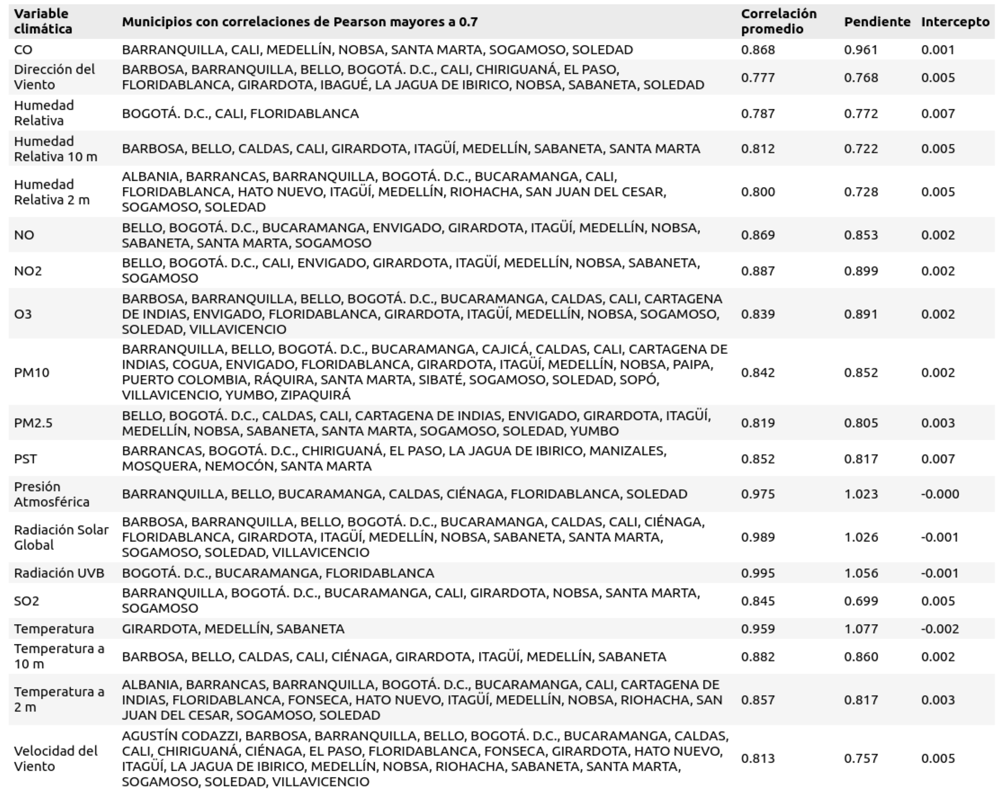

In [315]:
imshow_plots("dataf.png")

# Conclusiones

En conclusión, el análisis realizado hasta ahora muestra resultados prometedores al identificar correlaciones lineales significativas entre variables climáticas en diferentes municipios. Se ha logrado ajustar un modelo lineal bajo ciertas condiciones en casi todos los casos, con mínimas excepciones, lo que sugiere que las variables climáticas entre municipios tienden a seguir patrones lineales bajo ciertas circunstancias. Sin embargo, aún queda mucho por explorar. Debido a las limitaciones de tiempo, no se ha abordado el estudio de dinámicas no lineales, las cuales podrían revelar comportamientos más complejos y realistas de las variables climáticas.

Además, se aplicó el umbral del IQR (rango intercuartílico) a todas las variables climáticas, pero solo los datos de precipitación fueron completamente excluidos debido a este filtro. Esto sugiere que los datos de precipitación presentaron una variabilidad significativa o valores atípicos que el IQR descartó, lo que hace necesario explorar métodos alternativos para analizar estos datos y entender mejor su comportamiento. Las precipitaciones extremas pueden ser clave para comprender fenómenos climáticos abruptos, por lo que es fundamental revisarlas con mayor detalle.

En resumen, aunque se ha avanzado significativamente en el análisis inicial, es crucial continuar investigando, particularmente en dinámicas no lineales y en la revisión de datos extremos, para obtener una visión más completa y precisa del comportamiento climático en diferentes municipios.

# Anexos

En esta sección, se presenta una librería de funciones especialmente diseñada para el trabajo realizado en este proyecto. Esta librería incluye varias funciones repetitivas y útiles que han sido fundamentales para el análisis y procesamiento de datos climáticos. La inclusión de estas funciones tiene varias ventajas:

1. **Eficiencia y Reutilización:** Al centralizar funciones repetitivas en una librería, se mejora la eficiencia del código y se evita la duplicación. Esto permite que las tareas comunes, como la manipulación de datos o el ajuste de modelos, se realicen de manera más rápida y consistente en diferentes partes del proyecto.

2. **Organización y Mantenimiento:** Tener una librería dedicada facilita la organización del código, haciendo que el proyecto sea más fácil de entender y mantener. Cualquier cambio en las funciones puede hacerse de manera centralizada, evitando la necesidad de modificar múltiples scripts individuales.

3. **Consistencia en el Análisis:** La utilización de funciones estándar garantiza que los métodos aplicados sean consistentes en todo el proyecto. Esto es crucial para asegurar la validez y la reproducibilidad de los resultados obtenidos.

4. **Facilidad de Uso:** La librería proporciona una interfaz clara para realizar operaciones comunes, simplificando el proceso para los usuarios que interactúan con el código. Las funciones están diseñadas para ser intuitivas y fáciles de aplicar, lo que reduce el tiempo requerido para realizar tareas complejas.

En resumen, la integración de esta librería de funciones no solo optimiza el flujo de trabajo, sino que también asegura una ejecución más robusta y uniforme del análisis de datos. Su implementación es un paso importante para mejorar la calidad y la eficiencia del trabajo realizado en este proyecto.

In [322]:
import numpy as np
from datetime import datetime
import pandas as pd
from scipy import stats
from matplotlib.pylab import plt
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import ListedColormap
import matplotlib as mpl
from iminuit import Minuit
from probfit import Chi2Regression


def imshow_plots(img_path, figsize=(30, 25)):
    """
    Muestra una imagen en un gráfico con un tamaño específico.

    Parámetros:
    img_path (str): La ruta del archivo de la imagen a mostrar.
    figsize (tuple): El tamaño de la figura en pulgadas (ancho, alto).
    """
    fig = plt.figure(figsize=figsize)
    img = np.asarray(Image.open(img_path))
    plt.imshow(img)
    plt.axis("off")
    plt.show()


def fig_plots(
    x,
    y,
    pplt,
    color="blue",
    nejex="Eje x",
    nejey="Eje y",
    titulo="Titulo",
    labelsize=20,
    fontsize=20,
):
    """
    Muestra una imagen en un gráfico con un tamaño específico.

    Parámetros:
    img_path (str): La ruta del archivo de la imagen a mostrar.
    figsize (tuple): El tamaño de la figura en pulgadas (ancho, alto).
    """
    pplt.plot(x, y, "-", color=color)
    pplt.tick_params(labelsize=labelsize * 0.8)
    pplt.tick_params(labelsize=labelsize * 0.8)
    pplt.xlabel(nejex, labelpad=20, fontsize=labelsize)
    pplt.ylabel(nejey, labelpad=20, fontsize=labelsize)
    pplt.title(titulo, fontsize=fontsize)


def datos_plots(
    o,
    matriz_dataframe,
    nNbins,
    densidad,
    eje_x=["Eje x", "Eje x"],
    eje_y=["Eje y", "Eje y"],
    titulo=["Titulo", "Titulo"],
    labelsize=20,
    fontsize=20,
    figsize=(30, 10),
    wspace=0.3,
):
    """
    Muestra una imagen en un gráfico con un tamaño específico.

    Parámetros:
    img_path (str): La ruta del archivo de la imagen a mostrar.
    figsize (tuple): El tamaño de la figura en pulgadas (ancho, alto).
    """
    matriz_data_frame = [u for u in matriz_dataframe if u]
    nbins = [u for u in nNbins if u]
    figura, ax = plt.subplots(nrows=1, ncols=2, figsize=figsize)
    for u, lista_dataframe in enumerate(matriz_data_frame):
        for df in lista_dataframe:
            df[densidad].plot(style=".", ax=ax[u])
            ax[u].tick_params(labelsize=labelsize * 0.9)
            ax[u].tick_params(labelsize=labelsize * 0.9)
            ax[u].set_xlabel(eje_x[u], labelpad=20, fontsize=labelsize)
            ax[u].set_ylabel(eje_y[u], labelpad=20, fontsize=labelsize)
            ax[u].set_title(titulo[u], pad=25, fontsize=fontsize)

    figura.tight_layout()
    plt.subplots_adjust(wspace=wspace)
    figura.savefig(f"plots/dispers{o}.png", bbox_inches="tight")


def figure_plots(
    o,
    matriz_dataframe,
    nNbins,
    densidad,
    eje_x=["Eje x", "Eje x"],
    eje_y=["Eje y", "Eje y"],
    titulo=["Titulo", "Titulo"],
    labelsize=20,
    fontsize=20,
    figsize=(30, 10),
    wspace=0.3,
):
    """
    Muestra una imagen en un gráfico con un tamaño específico.

    Parámetros:
    img_path (str): La ruta del archivo de la imagen a mostrar.
    figsize (tuple): El tamaño de la figura en pulgadas (ancho, alto).
    """
    matriz_data_frame = [u for u in matriz_dataframe if u]
    nbins = [u for u in nNbins if u]
    figura, ax = plt.subplots(nrows=1, ncols=2, figsize=figsize)
    for u, lista_dataframe in enumerate(matriz_data_frame):
        for df in lista_dataframe:
            df[densidad].hist(
                bins=nbins[u],
                ax=ax[u],
                density=True,
                grid=False,
                histtype="step",
                linewidth=3,
            )
            # frm = r'${:.0f}$'
            # xlist = np.linspace(np.min(df[densidad]), np.max(df[densidad]), 6)
            # ax[u].xaxis.set_major_locator(mticker.FixedLocator(xlist))
            # ax[u].set_xticklabels([frm.format(x) for x in xlist],fontsize=14)
            ax[u].tick_params(labelsize=labelsize * 0.9)
            ax[u].tick_params(labelsize=labelsize * 0.9)
            ax[u].set_xlabel(eje_x[u], labelpad=20, fontsize=labelsize)
            ax[u].set_ylabel(eje_y[u], labelpad=20, fontsize=labelsize)
            ax[u].set_title(titulo[u], pad=25, fontsize=fontsize)
            # ax[u].yaxis.set_data_interval(0, 0.065 ,True)

    figura.tight_layout()
    plt.subplots_adjust(wspace=wspace)
    figura.savefig(f"plots/Graf{o}.png", bbox_inches="tight")


def bulk_data_grouping(conjunto_de_datos, agrupando_chunk, directorio_save):
    """
    Esta función agrupa y guarda  conjunto masivos  de datos

    conjunto_de_datos: conjuntos de datos pd.read_csv(...)

    agrupando_chunk: variable que contiene el nombre de una columna dataframe
      con la que quieres agrupar el conjunto masivo de datos.

    directorio_save: esta varialbe debe contener la direccion
    donde vas a gurdar los datos agrupados.

    """
    grupos_acumulados = {}
    for chunk in conjunto_de_datos:
        grouped = chunk.groupby(agrupando_chunk)
        for nombre_grupo, grupo in grouped:
            if nombre_grupo in grupos_acumulados:
                grupos_acumulados[nombre_grupo] = pd.concat(
                    [grupos_acumulados[nombre_grupo], grupo]
                )
            else:
                grupos_acumulados[nombre_grupo] = grupo

    # Guardar cada grupo acumulado en archivos CSV separados
    for nombre_grupo, grupo in grupos_acumulados.items():
        # se puede modificar el nombre del grupo con las dos lineas de codigo comentadas
        # y realizando un par de modificaciones
        # i = np.where(np.array(list(variables_contaminacion.values())) == nombre_grupo)[0]
        # name_archivo = np.array(list(variables_contaminacion.keys()))[i]
        nombre_archivo = f"{nombre_grupo}.csv"
        grupo.to_csv(directorio_save + nombre_archivo, index=False)
        print(f"Guardado: {nombre_archivo}")


def umbral_iqr(dataframe, variable):
    """
    Esta función filtra los datos hubicado dentro de los bigotes del boxplot, eliminando
    los valores atípicos que se encuentran fuera del rango delimitado
    por los bigotes inferior y superior

    dataframe: este parametro recibe un dataframe.
    variable: columna especifica de datos del dataframe

    """

    Q1 = dataframe[variable].quantile(0.25)
    Q3 = dataframe[variable].quantile(0.75)
    iqr = Q3 - Q1
    lower_limit = Q1 - 1.5 * iqr
    upper_limit = Q3 + 1.5 * iqr

    return lower_limit, upper_limit


def covertir_formato_24_horas(fecha_12_horas):
    """
    esta función convierte los datos de fecha que están en
    formato 12 horas  a fechas en formato 24 horas

    fecha_12_horas: este parámetro recibe una lista de fechas
    en formato 12 horas
    """
    # Convertir la fecha y hora de 12 horas a formato de 24 horas
    fecha_en_formato_24_horas = []
    for formatear_fecha in fecha_12_horas:
        fecha_24_horas = datetime.strptime(formatear_fecha, "%d/%m/%Y %I:%M:%S %p")
        fecha_en_formato_24_horas.append(fecha_24_horas)
    fecha_hora_con_formato = [
        darformato.strftime("%d/%m/%Y %H:%M:%S")
        for darformato in fecha_en_formato_24_horas
    ]

    return fecha_hora_con_formato


def fechas_en_horas(lista_fechas_horas, fecha_referencia=datetime(1970, 1, 1, 0, 0, 0)):
    """
    Esta funcion recibe datos de fechas en formato  "%d/%m/%Y %H:%M:%S" y las convierte
    a horas.

    lista_fechas_horas: parametro que recibe una lista de fechas en formato "%d/%m/%Y %H:%M:%S"
    fecha_referencia: parametro que recibe una fecha de referencia, por defecto es
    1970, 1, 1, 0, 0, 0

    """

    horas = []
    for fecha_hora in lista_fechas_horas:
        # Convertir la fecha y hora a datetime
        fecha_hora_dt = datetime.strptime(fecha_hora, "%d/%m/%Y %H:%M:%S")
        # Calcular la diferencia en horas respecto a la fecha de referencia
        diferencia = (fecha_hora_dt - fecha_referencia).total_seconds() / 3600
        horas.append(diferencia)
    return horas


def corr_pearsonr0(sizeclas):
    array_corr_perason = []
    array_corr_pevalue = []
    for xi in range(len(sizeclas[:, 0])):
        corr_perason = []
        pvalue_perason = []
        for yi in range(len(sizeclas[:, 0])):
            varcorrpearson = stats.pearsonr(sizeclas[xi, :], sizeclas[yi, :])
            corr_perason.append(varcorrpearson[0])
            pvalue_perason.append(varcorrpearson[1])
            # Jensen_Shannon_divergence(sizeclas[xi,:], sizeclas[yi,:]))  #
        array_corr_perason.append(corr_perason)
        array_corr_pevalue.append(pvalue_perason)
    array_corr_perason = np.array(array_corr_perason)
    array_corr_pevalue = np.array(array_corr_pevalue)
    return array_corr_perason, array_corr_pevalue


def plot_corr_pearsonr(
    harvest,
    titulos,
    farmers,
    figsize=(30, 25),
    labelsize=10,
    fontsize=10,
    fontz=10,
    tight_layout=True,
    pad=20,
):
    fig = plt.figure(figsize=figsize, tight_layout=tight_layout)
    gs = gridspec.GridSpec(1, 2)
    ax0 = fig.add_subplot(gs[0, 0])
    ax1 = fig.add_subplot(gs[0, 1])
    ax = [ax0, ax1]
    Color = ["black", "white"]
    for ut, ax in enumerate(ax):
        pc = ax.imshow(harvest[ut])

        # Show all ticks and label them with the respective list entries
        ax.set_xticks(np.arange(len(farmers[0])), labels=farmers[0])
        ax.set_yticks(np.arange(len(farmers[1])), labels=farmers[1])

        # Rotate the tick labels and set their alignment.
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

        # Loop over data dimensions and create text annotations.
        for i in range(len(farmers[0])):
            for j in range(len(farmers[1])):
                text = ax.text(
                    j,
                    i,
                    round(harvest[ut][i, j], 3),
                    ha="center",
                    va="center",
                    fontsize=fontz,
                    color=Color[ut],
                )

        ax.set_title(titulos[ut], fontsize=fontsize, pad=pad)
        ax.tick_params(labelsize=labelsize)
        ax.tick_params(labelsize=labelsize)
    fig.tight_layout()
    fig.savefig("cvclima.pdf")
    return plt.show()


def corr_pearsonr(sizeclas):
    array_corr_perason = []
    array_corr_pevalue = []
    for xi in range(len(sizeclas[:, 0])):
        corr_perason = []
        pvalue_perason = []
        for yi in range(len(sizeclas[:, 0])):
            varcorrpearson = stats.pearsonr(sizeclas[xi, :], sizeclas[yi, :])
            corr_perason.append(varcorrpearson[0])
            pvalue_perason.append(varcorrpearson[1])
            # Jensen_Shannon_divergence(sizeclas[xi,:], sizeclas[yi,:]))  #
        array_corr_perason.append(corr_perason)
        array_corr_pevalue.append(pvalue_perason)
    array_corr_perason = np.array(array_corr_perason)
    array_corr_pevalue = np.array(array_corr_pevalue)
    return array_corr_perason, array_corr_pevalue


def plt_corr_pears(
    harvest,
    titulos,
    farmers,
    figsize=(30, 25),
    labelsize=10,
    fontsize=10,
    tight_layout=True,
    padd=20,
    formato=r"${:.2f}$",
    descript=["Descripción", "Descripción"],
    nNums=10,
    size="4%",
    padr="15%",
    descrip_bar=20,
    var_clima="varclima",
    wspace=1.5,
):
    fig = plt.figure(figsize=figsize, tight_layout=tight_layout)
    xmicol1 = "viridis"
    xcmap = mpl.colormaps[xmicol1].resampled(250)
    xnewcolors = xcmap(np.linspace(0, 1, 250))
    cmap = ListedColormap(xnewcolors)
    gs = gridspec.GridSpec(1, 2)
    ax0 = fig.add_subplot(gs[0, 0])
    ax1 = fig.add_subplot(gs[0, 1])
    ax = [ax0, ax1]
    for ut, ax in enumerate(ax):
        pc = ax.imshow(harvest[ut])

        # Show all ticks and label them with the respective list entries
        ax.set_xticks(np.arange(len(farmers[0])), labels=farmers[0])
        ax.set_yticks(np.arange(len(farmers[1])), labels=farmers[1])

        # Rotate the tick labels and set their alignment.
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
        ax.set_title(titulos[ut], fontsize=fontsize, pad=padd)
        ax.tick_params(labelsize=labelsize)
        ax.tick_params(labelsize=labelsize)

        ticks_loc = np.linspace(np.min(harvest[ut]), np.max(harvest[ut]), nNums)

        norm = matplotlib.colors.Normalize(
            vmin=np.min(harvest[ut]), vmax=np.max(harvest[ut])
        )
        sm = matplotlib.cm.ScalarMappable(cmap=cmap, norm=norm)
        ax2_divider = make_axes_locatable(ax)
        cax0 = ax2_divider.append_axes("right", size=size, pad=padr)
        cbar0 = fig.colorbar(pc, extend="both", cax=cax0, orientation="vertical")
        cbar0.ax.set_ylabel(descript[ut], fontsize=descrip_bar)
        cbar0.ax.yaxis.set_major_locator(mticker.FixedLocator(ticks_loc))
        cbar0.ax.set_yticklabels(
            [formato.format(x) for x in ticks_loc], fontsize=descrip_bar * 0.8
        )
    fig.tight_layout()
    plt.subplots_adjust(wspace=wspace)
    fig.savefig(f"plots/{var_clima}_corr.png", bbox_inches="tight")
    return plt.show()


def model_fit(x, m, b):
    f = b + x * m
    return f


def plots_lineal_model(
    z,
    mx,
    n_var=["i", "j"],
    titX=["x", "x"],
    titY=["y", "y"],
    limX=[1, 1],
    limY=[1, 1],
    ngr=0,
):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))
    for u, array_freq in enumerate(mx):
        enx = []
        eny = []
        nN = len(np.array(array_freq)[:, 0])
        for i in range(nN):
            for j in range(i + 1, nN):
                ai = list(np.array(array_freq)[i])
                aj = list(np.array(array_freq)[j])
                corr, _ = pearsonr(ai, aj)
                if corr > 0.7:
                    enx += list(ai)
                    eny += list(aj)
                    xi = np.array(ai, dtype=float)
                    yi = np.array(aj, dtype=float)
                    ax[u].plot(xi[xi < z], yi[xi < z], "o", label="Datos")

        x = np.array(enx, dtype=float)
        y = np.array(eny, dtype=float)
        xx = x[x < z]
        yy = y[x < z]
        chi2 = Chi2Regression(model_fit, xx, yy)
        p = Minuit(chi2, m=1, b=1)
        p.migrad()

        m_fit = p.values["m"]
        b_fit = p.values["b"]
        print(f"Parámetros ajustados: a={m_fit:.2f}, b={b_fit:.2f}")
        ax[u].plot(
            xx,
            model_fit(xx, m_fit, b_fit),
            color="black",
            label=f"Ajuste: a={m_fit:.2f}, b={b_fit:.2f}",
        )

        ax[u].set_xlabel(f"{titX[u]}", labelpad=20, fontsize=30)
        ax[u].set_ylabel(f"{titY[u]}", labelpad=20, fontsize=30)
        ax[u].set_title(f"{n_var[u]}", pad=25, fontsize=30)
        ax[u].tick_params(labelsize=30 * 0.9)
        ax[u].tick_params(labelsize=30 * 0.9)
        ax[u].set_xlim(-0.005, limX[u])
        ax[u].set_ylim(-0.005, limY[u])
        # ax[u].legend(fontsize=15)
    fig.tight_layout()
    plt.subplots_adjust(wspace=0.3)
    fig.savefig(f"plots/gxGraf{ngr}.png", bbox_inches="tight")
    plt.show()


def param_lineal_model(z, array_freq, xmunic):
    enx = []
    eny = []
    valcorr = []
    mun_val = []
    nN = len(np.array(array_freq)[:, 0])
    for i in range(nN):
        for j in range(i + 1, nN):
            ai = list(np.array(array_freq)[i])
            aj = list(np.array(array_freq)[j])
            corr, _ = pearsonr(ai, aj)
            if corr > 0.7:
                valcorr.append(corr)
                mun_val.append([xmunic[i], xmunic[j]])
                enx += list(ai)
                eny += list(aj)
                xi = np.array(ai, dtype=float)
                yi = np.array(aj, dtype=float)

    x = np.array(enx, dtype=float)
    y = np.array(eny, dtype=float)
    xx = x[x < z]
    yy = y[x < z]
    chi2 = Chi2Regression(model_fit, xx, yy)
    p = Minuit(chi2, m=1, b=1)
    p.migrad()

    m_fit = round(p.values["m"], 3)
    b_fit = round(p.values["b"], 3)
    return m_fit, b_fit, mun_val, valcorr

In [323]:
!jupyter nbconvert --to latex datosaire.ipynb

[NbConvertApp] Converting notebook datosaire.ipynb to latex
/home/alejandro/.pyenv/versions/djworkspace/lib/python3.8/site-packages/nbconvert/utils/pandoc.py:50: RuntimeWarning: You are using an unsupported version of pandoc (2.5).
Your version must be at least (2.9.2) but less than (4.0.0).
Refer to https://pandoc.org/installing.html.
Continuing with doubts...
  check_pandoc_version()
[NbConvertApp] Support files will be in datosaire_files/
[NbConvertApp] Writing 205158 bytes to datosaire.tex
